<a href="https://colab.research.google.com/github/shaySitri/MultiPatch/blob/main/MultiPatchAttack.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Multi-Orientation Adversarial Patch

Nitay Yakoby, Kalanit Segal, Noy Gabay, Shay Sitri

This notebook demonstrates the creation and evaluation of adversarial patches for deep learning models. The primary objective is to investigate targeted adversarial attacks, where the adversarial patch is specifically designed to manipulate a model's classification output by causing it to misclassify an input into a predetermined incorrect class. The notebook covers two main methodologies for generating adversarial patches: one based on Projected Gradient Descent (PGD) and another using Fast Gradient Sign Method (FGSM) with random initialization. Both methods aim to optimize the patch's design in such a way that it can mislead the model when placed on an image, under various rotations, including 90°, 30°, 60°, and full 360° rotations.


---

## **Overview**

1. Setup and Initialization
2. General Functions: Patch Placement, Visualizations, Patch Evaluation
3. Patch Creating Methods
4. Experiments with square patches, followed by a summary of the results
5. Experiments with circular patches, followed by a summary of the results
6. Overall summary includes comparison between square and circular patches








# Imports and Initialization

In [ ]:
## Standard libraries
import os
import json
import math
import time
import numpy as np
import scipy.linalg
import tabulate
from IPython.display import display, HTML
import itertools
## Imports for plotting
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'pdf') # For export
from matplotlib.colors import to_rgb
import matplotlib
matplotlib.rcParams['lines.linewidth'] = 2.0
import seaborn as sns
sns.set()
import tabulate
from IPython.display import display, HTML

## Progress bar
from tqdm.notebook import tqdm

## PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
import torch.optim as optim
import torchvision.transforms.functional as TF

# Torchvision
import torchvision
# from torchvision.datasets import CIFAR10
from torchvision import transforms
# PyTorch Lightning
try:
    import pytorch_lightning as pl
except ModuleNotFoundError: # Google Colab does not have PyTorch Lightning installed by default. Hence, we do it here if necessary
    !pip install --quiet pytorch-lightning>=1.4
    import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint

# Path to the folder where the datasets are/should be downloaded (e.g. MNIST)
DATASET_PATH = "../data"
# Path to the folder where the pretrained models are saved
CHECKPOINT_PATH = "../saved_models/experiments"

# Setting the seed
pl.seed_everything(42)

# Ensure that all operations are deterministic on GPU (if used) for reproducibility
torch.backends.cudnn.determinstic = True
torch.backends.cudnn.benchmark = False

# Fetching the device that will be used throughout this notebook
device = torch.device("cpu") if not torch.cuda.is_available() else torch.device("cuda:0")
print("Using device", device)

<ipython-input-11-588ba2bc8473>:15: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('svg', 'pdf') # For export
INFO:lightning_fabric.utilities.seed:Seed set to 42


Using device cuda:0


In [ ]:
import urllib.request
from urllib.error import HTTPError
import zipfile
# Github URL where the dataset is stored for this tutorial
base_url = "https://raw.githubusercontent.com/phlippe/saved_models/main/tutorial10/"
# Files to download
pretrained_files = [(DATASET_PATH, "TinyImageNet.zip"), (CHECKPOINT_PATH, "patches.zip")]
# Create checkpoint path if it doesn't exist yet
os.makedirs(DATASET_PATH, exist_ok=True)
os.makedirs(CHECKPOINT_PATH, exist_ok=True)

# For each file, check whether it already exists. If not, try downloading it.
for dir_name, file_name in pretrained_files:
    file_path = os.path.join(dir_name, file_name)
    if not os.path.isfile(file_path):
        file_url = base_url + file_name
        print(f"Downloading {file_url}...")
        try:
            urllib.request.urlretrieve(file_url, file_path)
        except HTTPError as e:
            print("Something went wrong. Please try to download the file from the GDrive folder, or contact the author with the full output including the following error:\n", e)
        if file_name.endswith(".zip"):
            print("Unzipping file...")
            with zipfile.ZipFile(file_path, 'r') as zip_ref:
                zip_ref.extractall(file_path.rsplit("/",1)[0])

In [ ]:
# Load CNN architecture pretrained on ImageNet
os.environ["TORCH_HOME"] = CHECKPOINT_PATH
pretrained_model = torchvision.models.resnet34(pretrained=True)
pretrained_model = pretrained_model.to(device)

# No gradients needed for the network
pretrained_model.eval()
for p in pretrained_model.parameters():
    p.requires_grad = False

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
%%html
<!-- Some HTML code to increase font size in the following table -->
<style>
th {font-size: 120%;}
td {font-size: 120%;}
</style>

In [ ]:
class_names = []
patch_sizes = []

In [ ]:
# Mean and Std from ImageNet
NORM_MEAN = np.array([0.485, 0.456, 0.406])
NORM_STD = np.array([0.229, 0.224, 0.225])
# No resizing and center crop necessary as images are already preprocessed.
plain_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=NORM_MEAN,
                         std=NORM_STD)
])

# Load dataset and create data loader
imagenet_path = os.path.join(DATASET_PATH, "TinyImageNet/")
assert os.path.isdir(imagenet_path), f"Could not find the ImageNet dataset at expected path \"{imagenet_path}\". "
dataset = torchvision.datasets.ImageFolder(root=imagenet_path, transform=plain_transforms)
data_loader = data.DataLoader(dataset, batch_size=32, shuffle=False, drop_last=False, num_workers=2)

# Load label names to interpret the label numbers 0 to 999
with open(os.path.join(imagenet_path, "label_list.json"), "r") as f:
    label_names = json.load(f)

def get_label_index(lab_str):
    assert lab_str in label_names, f"Label \"{lab_str}\" not found. Check the spelling of the class."
    return label_names.index(lab_str)

In [ ]:
def show_prediction(img, label, pred, K=5, adv_img=None, patch=None):
    """
    Visualizes the input image and prediction results, optionally displaying patched images.

    Parameters:
    ----------
    img : torch.Tensor or numpy.ndarray
        The input image. If a tensor, it is converted to a numpy array.
    label : torch.Tensor or int
        The true label of the input image. If a tensor, it is converted to an integer.
    pred : torch.Tensor
        The prediction probabilities for each class.
    K : int, optional
        The top K predictions to display in the bar chart (default is 5).
    adv_img : torch.Tensor or None, optional
        Adversarial image, if available. Default is None.
    patch : torch.Tensor or None, optional
        Patch applied to the image, if available. Default is None.

    """
    if isinstance(img, torch.Tensor):
        # Convert tensor image to numpy array
        img = img.cpu().permute(1, 2, 0).numpy()
        img = (img * NORM_STD[None,None]) + NORM_MEAN[None,None]
        img = np.clip(img, a_min=0.0, a_max=1.0)
        label = label.item()

    # Determine the plotting structure based on the presence of image and patch
    fig, ax = plt.subplots(1, 2, figsize=(10,2), gridspec_kw={'width_ratios': [1, 1]}) if patch is None or adv_img is None else plt.subplots(1, 5, figsize=(12,2), gridspec_kw={'width_ratios': [1, 1, 1, 1, 2]})

    # Plot original image
    ax[0].imshow(img)
    ax[0].set_title(label_names[label])
    ax[0].axis('off')

    if adv_img is not None and patch is not None:
        # Visualize adversarial image
        adv_img = adv_img.cpu().permute(1, 2, 0).numpy()
        adv_img = (adv_img * NORM_STD[None,None]) + NORM_MEAN[None,None]
        adv_img = np.clip(adv_img, a_min=0.0, a_max=1.0)
        ax[1].imshow(adv_img)
        ax[1].set_title('Adversarial')
        ax[1].axis('off')
        # Visualize patch
        patch = patch.cpu().permute(1, 2, 0).numpy()
        patch = patch * 0.5 + 0.5  # Scale between 0 to 1
        ax[2].imshow(patch)
        ax[2].set_title('Patch')
        ax[2].axis('off')
        # Buffer
        ax[3].axis('off')

    # Ensure predictions sum up to 1
    if abs(pred.sum().item() - 1.0) > 1e-4:
        pred = torch.softmax(pred, dim=-1)
    topk_vals, topk_idx = pred.topk(K, dim=-1)
    topk_vals, topk_idx = topk_vals.cpu().numpy(), topk_idx.cpu().numpy()

    # Plot prediction probabilities
    ax[-1].barh(np.arange(K), topk_vals*100.0, align='center', color=["C0" if topk_idx[i]!=label else "C2" for i in range(K)])
    ax[-1].set_yticks(np.arange(K))
    ax[-1].set_yticklabels([label_names[c] for c in topk_idx])
    ax[-1].invert_yaxis()
    ax[-1].set_xlabel('Confidence')
    ax[-1].set_title('Predictions')
    plt.show()
    plt.close()


In [ ]:
exmp_batch, label_batch = next(iter(data_loader))

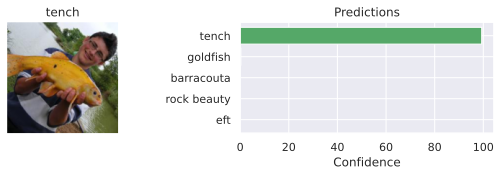

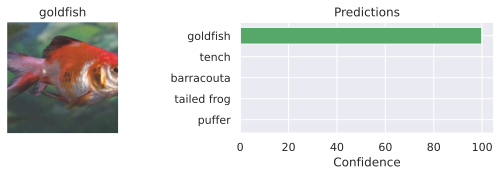

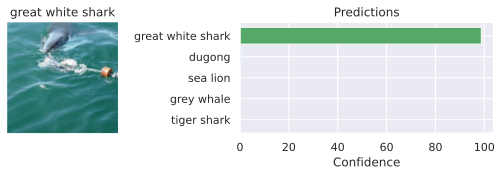

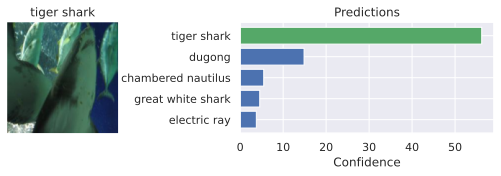

In [ ]:
with torch.no_grad():
    preds = pretrained_model(exmp_batch.to(device))
for i in range(1,17,5):
    show_prediction(exmp_batch[i], label_batch[i], preds[i])

# General Functions

In [ ]:
TENSOR_MEANS, TENSOR_STD = torch.FloatTensor(NORM_MEAN)[:,None,None], torch.FloatTensor(NORM_STD)[:,None,None]
def patch_forward(patch):
    """
    Transforms a patch tensor to match the ImageNet value range using tanh and normalization.

    Parameters:
    -----------
    patch : torch.Tensor
        A tensor representing the patch, typically in an unconstrained range.

    Returns:
    --------
    torch.Tensor
        A normalized patch tensor scaled to the ImageNet pixel value range.
    """
    # Map patch values from [-infty,infty] to ImageNet min and max
    patch = (torch.tanh(patch) + 1 - 2 * TENSOR_MEANS.to(patch.device)) / (2 * TENSOR_STD.to(patch.device))
    return patch

In [ ]:
def create_circular_patch(size):
    """
    Create a circular binary mask of a given size.

    Parameters:
    -----------
    size : int
        The height and width of the output square tensor. The circle is inscribed
        within this square.

    Returns:
    --------
    mask : torch.Tensor
        A tensor of shape (size, size) containing values:
        - 1.0 for pixels inside the circle
        - 0.0 for pixels outside the circle
    """

    Y, X = torch.meshgrid(torch.arange(size), torch.arange(size), indexing='ij')
    center = size // 2
    radius = size // 2
    dist = torch.sqrt((X - center) ** 2 + (Y - center) ** 2)
    mask = (dist <= radius).float()  # 1 inside the circle, 0 outside
    return mask


In [ ]:
def place_patch(img, patch): # img is a batch
    """
    Places a transformed patch onto randomly selected locations within each image in a batch.

    Parameters:
    -----------
    img : torch.Tensor
        A batch of images with shape (B, C, H, W), where:
        - B: batch size
        - C: number of channels
        - H: image height
        - W: image width

    patch : torch.Tensor
        A patch tensor with shape (C, P_H, P_W), where:
        - C: number of channels (must match the image channels)
        - P_H: patch height
        - P_W: patch width

    Returns:
    --------
    torch.Tensor
        The modified batch of images with the patch applied to random locations.
    """

    for i in range(img.shape[0]):
        h_offset = np.random.randint(0,img.shape[2]-patch.shape[1]-1)
        w_offset = np.random.randint(0,img.shape[3]-patch.shape[2]-1)
        img[i,:,h_offset:h_offset+patch.shape[1],w_offset:w_offset+patch.shape[2]] = patch_forward(patch)
    return img

In [ ]:
def place_patch_circle(img, patch):
    """
    Places a circular patch at a random location within each image in a batch.

    Parameters:
    -----------
    img : torch.Tensor
        A batch of images of shape (batch_size, channels, height, width).

    patch : torch.Tensor
        A patch tensor of shape (channels, patch_height, patch_width).
        It should be a square patch where the circular region will be applied.

    Returns:
    --------
    torch.Tensor
        The modified batch of images with the circular patch applied at random positions.

    """

    device = img.device  # Ensure consistency
    img = img.to(device)
    patch = patch.to(device)

    for i in range(img.shape[0]):
        h_offset = np.random.randint(0, img.shape[2] - patch.shape[1] - 1)
        w_offset = np.random.randint(0, img.shape[3] - patch.shape[2] - 1)

        # Get the patch region in the image
        patch_area = img[i, :, h_offset:h_offset + patch.shape[1], w_offset:w_offset + patch.shape[2]]

        # Apply the circular patch using the mask
        mask = create_circular_patch(patch.shape[1]).to(device)
        img[i, :, h_offset:h_offset + patch.shape[1], w_offset:w_offset + patch.shape[2]] = (
            patch * mask + patch_area * (1 - mask)
        )

    return img


In [ ]:
def show_table_with_rotation(top_1=True, rot_patches={}, acc='acc', rotations = [0]):
    """
    Display accuracy results for both original and rotated patches in an HTML table.

    Parameters:
    -----------
    top_1 : bool, optional (default=True)
        If True, displays top-1 accuracy; otherwise, displays top-5 accuracy.

    rot_patches : dict
        A dictionary containing accuracy results for different class pairs and patch sizes.

    acc : str, optional (default='acc')
        The accuracy key to use (key in rot_patches which contains accuracy metric).

    rotations : list, optional (default=[0])
        A list of rotation angles applied to the patches.
    """
    0 if top_1 else 1  # Index to determine top-1 or top-5 accuracy

    rot_num = len(rot_patches[list(rot_patches.keys())[0]][patch_sizes[0]]['results'])

    table = []
    headers = ["Class pair"] + \
              [f"Orig {psize}x{psize}" for psize in patch_sizes] + \
              [f"Rotated {psize}x{psize}" for psize in patch_sizes] * (rot_num - 1)

        # Add an additional row for rotation angles
    sub_headers = [""] + \
                  [f"Rot {angle}°" for angle in rotations for _ in patch_sizes]


    for class_pair in rot_patches.keys():
        row = [class_pair]
        for psize in patch_sizes:

            if len(rotations) < 3:
                for rot in rot_patches[class_pair][psize]['results']:
                # Original patch accuracy
                    new_row = f"{(100.0 * rot_patches[class_pair][psize]['results'][rot][acc if top_1 else 'top5']):4.2f}%"
                    row.append(new_row)
            else:
                for rot in rotations:
                    rot_key = f"rotation_{rot}"
                    rot_acc = f"{(100.0 * rot_patches[class_pair][psize]['results'][rot_key][acc if top_1 else 'top5']):4.2f}%"
                    row.append(rot_acc)

        table.append(row)

    html_table = tabulate.tabulate(table, tablefmt='html', headers=headers)

    if len(rotations) > 2:
        sub_header_html = "<tr>" + "".join(f"<th>{sub}</th>" for sub in sub_headers) + "</tr>"
        html_table = html_table.replace("<thead>", f"<thead>{sub_header_html}")

    display(HTML(html_table))



In [ ]:
def show_patches(rot_patches, patch_sizes, txt_size=12):
    """
    Display rotated patches for different class pairs and patch sizes.

    Parameters:
    -----------
    rot_patches : dict
        A dictionary containing rotated patch data.

    patch_sizes : list
        A list of integers representing the patch sizes to be displayed.

    txt_size : int, optional (default=12)
        Font size for the titles in the visualization.
    """


    fig, ax = plt.subplots(len(patch_sizes), len(rot_patches), figsize=(len(rot_patches) * 2.5, len(patch_sizes) * 2.5))

    # Iterate over class pairs and patch sizes
    for c_idx, pair_name in enumerate(rot_patches):
        for p_idx, psize in enumerate(patch_sizes):
            if psize in rot_patches[pair_name]:
                patch = rot_patches[pair_name][psize]["patch"]
                # Transform the patch into a displayable image
                patch = (torch.tanh(patch) + 1) / 2  # Parameter to pixel values
                patch = patch.cpu().permute(1, 2, 0).numpy()
                patch = np.clip(patch, a_min=0.0, a_max=1.0)
                if len(rot_patches) == 1:
                    ax[p_idx].imshow(patch)
                    ax[p_idx].set_title(f"{pair_name}, size {psize}", fontsize=txt_size)
                    ax[p_idx].axis('off')

                elif len(patch_sizes) == 1:
                    ax[c_idx].imshow(patch)
                    ax[c_idx].set_title(f"{pair_name}, size {psize}", fontsize=txt_size)
                    ax[c_idx].axis('off')

                else:
                    ax[p_idx][c_idx].imshow(patch)
                    ax[p_idx][c_idx].set_title(f"{pair_name}, size {psize}", fontsize=txt_size)
                    ax[p_idx][c_idx].axis('off')

    # Adjust layout
    fig.subplots_adjust(hspace=0.3, wspace=0.3)
    plt.show()


In [ ]:
def eval_patch(model, patch, val_loader, target_class, circle=False):
    """
    Evaluates the effectiveness of an adversarial patch by placing it on images and measuring
    how often it causes misclassification towards the target class.

    The patch is placed at four random locations per image to ensure robustness in the evaluation.

    Parameters:
    -----------
    model : torch.nn.Module
        The neural network model to evaluate.

    patch : torch.Tensor
        The adversarial patch to be placed on the images.

    val_loader : DataLoader
        DataLoader containing the validation dataset.

    target_class : int
        The target class that the patch attempts to mislead the model into predicting.

    circle : bool, optional (default=False)
        If True, places a circular patch using `place_patch_circle`; otherwise, uses `place_patch`.

    device : str, optional (default='cuda')
        The device ('cuda' or 'cpu') to perform computations on.

    Returns:
    --------
    dict
        A dictionary containing:
        - 'acc': Fooling rate (how often the model predicts `target_class` instead of the true class).
        - 'top5': Fooling rate within the top-5 predictions.
    """


    model.eval()
    tp, tp_5, counter = 0., 0., 0.
    with torch.no_grad():
        #for img, img_labels in tqdm(val_loader, desc="Validating...", leave=False):
        for img, img_labels in val_loader:
            # For stability, place the patch at 4 random locations per image, and average the performance
            for _ in range(4):
                if circle:
                    patch_img = place_patch_circle(img.clone(), patch)
                else:
                    patch_img = place_patch(img.clone(), patch)
                patch_img = patch_img.to(device)
                img_labels = img_labels.to(device)
                pred = model(patch_img)
                # In the accuracy calculation, we need to exclude the images that are of our target class
                # as we would not "fool" the model into predicting those
                tp += torch.logical_and(pred.argmax(dim=-1) == target_class, img_labels != target_class).sum()
                tp_5 += torch.logical_and((pred.topk(5, dim=-1)[1] == target_class).any(dim=-1), img_labels != target_class).sum()
                counter += (img_labels != target_class).sum()
    acc = tp/counter
    top5 = tp_5/counter
    return {'acc' : acc, 'top5' : top5}

In [ ]:
def perform_patch_attack(patch, circle = False, rotations=[0], target=None):
    """
    Performs an adversarial patch attack by applying rotated versions of the patch
    to a batch of images and evaluating the model's predictions.

    Parameters:
    -----------
    patch : torch.Tensor
        The adversarial patch to be applied.

    exmp_batch : torch.Tensor
        A batch of images to which the patch will be applied.

    label_batch : torch.Tensor
        The ground truth labels for the images in `exmp_batch`.

    pretrained_model : torch.nn.Module
        The pretrained model to evaluate the patch attack.

    device : str, optional (default='cuda')
        The device ('cuda' or 'cpu') to perform computations on.

    circle : bool, optional (default=False)
        If True, places a circular patch using `place_patch_circle`; otherwise, uses `place_patch`.

    rotations : list of int, optional (default=[0])
        List of rotation angles (in degrees) to apply to the patch.

    target : list, optional (default=None)
        If provided, prints the corresponding target label for each rotation.

    """

    patch = patch.to('cuda')
    for i in range(len(rotations)):
        angle = rotations[i]
        if target != None:
            print(target[i])
        rot_patch = TF.rotate(patch, angle=angle, expand=False)
        patch_batch = exmp_batch.clone()
        if circle:
            patch_batch = place_patch_circle(patch_batch, rot_patch)
        else:
            patch_batch = place_patch(patch_batch, rot_patch)
        with torch.no_grad():
            patch_preds = pretrained_model(patch_batch.to(device))
        for i in range(1,17,5):
            show_prediction(patch_batch[i], label_batch[i], patch_preds[i])

# Methods

This notebook explores the generation of **adversarial patches** using two different approaches. The goal is to train a patch that **misleads a model** into misclassifying an image into a specific class, even when the patch is rotated.  

### **Key Idea**
- **Adversarial patches** are small image regions with perturbations that significantly influence model predictions.  
- A **basic patch** is trained to force a model to classify an image as a **target class X**.  
- If the **patch is rotated 90°**, it now **targets a different class Y**.  
- With multiple rotations, a single patch can introduce **multiple distinct attacks**, making classification more difficult.

---

## **Loss Calculation**
To optimize the adversarial patch, we compute the **Cross-Entropy (CE) loss** across different rotations of the patch.  

### **Loss Formula**
The total loss is computed as:  

$$
\mathcal{L}_{\text{total}} = \sum_{i=1}^{N} \sum_{j=1}^{M} \text{CE}(f(x_i, p, \theta_j), y_j)
$$

Where:
- $( N $) = number of training samples in a batch  
- $( M $) = number of patch rotation angles  
- $( x_i $) = input image  
- $( p $) = adversarial patch  
- $( \theta_j $) = rotation angle applied at step \( j \)  
- $( f(x_i, p, \theta_j) $) = model’s output when applying the rotated patch  
- $( y_j )$ = target label associated with rotation \( \theta_j \)  
- $( \text{CE}(\cdot, \cdot) ) $ = Cross-Entropy loss function  

The objective is to ensure that the model **misclassifies** the image for all rotation angles, making the adversarial patch **effective from any orientation**.


## Method 1 - PGD Based

This method employs a Stochastic Gradient Descent (SGD) optimizer with momentum to iteratively update the adversarial patch. The optimizer allows for controlled and precise adjustments, ensuring the patch effectively deceives the model across different rotations. The patch is initialized as a zero-valued tensor of size (3, h, w), where h, w define the patch dimensions.



In [ ]:
def patch_attack(model, target_class, class_names, patch_size=64, num_epochs=5, rotation_angles=[0], circle=False):
    """
    Perform an adversarial patch attack on a model by generating a learnable patch and applying it
    to images in the dataset. The patch is updated using Stochastic Gradient Descent (SGD) with momentum
    and is evaluated for different rotation angles.

    Args:
        model (torch.nn.Module): The model to attack.
        target_class (int or list of int): The target class (or classes) that the attack aims to fool the model into predicting.
        class_names (list of str): List of class names corresponding to class indices.
        patch_size (int or tuple): The size of the patch. If an integer is provided, it is assumed to be square (patch_size x patch_size).
        num_epochs (int): The number of training epochs to update the patch.
        rotation_angles (list of int): List of angles by which the patch should be rotated.
        circle (bool): If True, a circular patch is used; otherwise, a rectangular patch is used.

    Returns:
        torch.Tensor: The final adversarial patch after training.
        dict: A dictionary containing the attack results (accuracy and top-5 accuracy) for each rotation angle.
    """

    # Leave a small set of images out to check generalization
    # In most of our experiments, the performance on the hold-out data points
    # was as good as on the training set. Overfitting was little possible due
    # to the small size of the patches.
    train_set, val_set = torch.utils.data.random_split(dataset, [4500, 500])
    train_loader = data.DataLoader(train_set, batch_size=32, shuffle=True, drop_last=True, num_workers=8)
    val_loader = data.DataLoader(val_set, batch_size=32, shuffle=False, drop_last=False, num_workers=4)

    # Create parameter, optimizer and circle mask.
    if not isinstance(patch_size, tuple):
        patch_size = (patch_size, patch_size)

    patch = nn.Parameter(torch.zeros(3, patch_size[0], patch_size[1]), requires_grad=True)
    circular_mask = create_circular_patch(patch_size[0]).to(patch.device)
    optimizer = torch.optim.SGD([patch], lr=1e-1, momentum=0.8)
    loss_module = nn.CrossEntropyLoss()

    # Training loop
    for epoch in range(num_epochs):
        for img, _ in train_loader:

            img = img.to(device)
            optimizer.zero_grad()  # Clear previous gradients
            total_loss = 0  # Reset total loss for the batch

            for idx, angle in enumerate(rotation_angles):

                if circle:
                    patch.data = patch.data * circular_mask

                rotated_patch = TF.rotate(patch, angle=angle, expand=False)  # Rotate patch

                # Apply the rotated patch to the image
                if circle:
                    img_rot = place_patch_circle(img.clone(), rotated_patch)
                else:
                    img_rot = place_patch(img.clone(), rotated_patch)

                pred_rot = model(img_rot)

                # Define target labels for the current rotation
                labels_rot = torch.zeros(img.shape[0], device=device, dtype=torch.long).fill_(target_class[idx])

                # Compute loss
                loss_rot = loss_module(pred_rot, labels_rot)
                total_loss += loss_rot  # Accumulate the loss across rotations


            # Backpropagation for the accumulated loss
            total_loss.backward()
            optimizer.step()

        print(f"Epoch {epoch}, Loss: {total_loss.item():4.2f}")

    # Final validation for each rotation
    results = {}
    for idx, angle in enumerate(rotation_angles):
        rotated_patch_final = TF.rotate(patch, angle=angle, expand=False)

        res = eval_patch(model, rotated_patch_final, val_loader, target_class[idx])
        results[f"rotation_{angle}"] = {
            "class": class_names[idx],
            "acc": res['acc'].item(),
            "top5": res['top5'].item()
        }


    return patch.data, results

## Method 2 - FGSM Based

In this method, we implement a strategy for generating adversarial patches using the Fast Gradient Sign Method (FGSM) to optimize the patch and mislead the model towards a target class. The patch is initialized randomly, and its updates are performed based on the gradient sign, eliminating the need for iterative optimization.



In [ ]:
def patch_attack_rot_multi_fgsm(model, target_class, class_names, patch_size=64, num_epochs=10, alpha=.1, eps=3, rotation_angles=[], circle=False):
    """
    Train a patch for adversarial attacks, optimizing for the target class before rotation
    and another target class after a 30-degree rotation while maintaining the square shape.

    Args:
        model (torch.nn.Module): The model to attack.
        target_class (int or list of int): The target class (or classes) that the attack aims to fool the model into predicting.
        class_names (list of str): List of class names corresponding to class indices.
        patch_size (int or tuple): The size of the patch. If an integer is provided, it is assumed to be square (patch_size x patch_size).
        num_epochs (int): The number of training epochs to update the patch.
        rotation_angles (list of int): List of angles by which the patch should be rotated.
        circle (bool): If True, a circular patch is used; otherwise, a rectangular patch is used.

    Returns:
        torch.Tensor: The final adversarial patch after training.
        dict: A dictionary containing the attack results (accuracy and top-5 accuracy) for each rotation angle.
    """
    train_set, val_set = torch.utils.data.random_split(dataset, [4500, 500])
    train_loader = torch.utils.data.DataLoader(train_set, batch_size=32, shuffle=True, drop_last=True, num_workers=4)
    val_loader = torch.utils.data.DataLoader(val_set, batch_size=32, shuffle=False, drop_last=False, num_workers=4)

    # Initialize the patch and move it to the appropriate device
    patch = torch.rand((3, patch_size, patch_size), dtype=torch.float, requires_grad=True)
    circular_mask = create_circular_patch(patch_size).to(patch.device)


    loss_module = nn.CrossEntropyLoss()

    for epoch in range(num_epochs):

        for img, _ in train_loader:
            total_loss = 0  # Reset total loss for the batch
            img = img.to('cuda')
            for idx, angle in enumerate(rotation_angles):
                # Rotate patch without cropping
                if circle:
                    patch.data = patch.data * circular_mask

                rotated_patch = TF.rotate(patch, angle=angle, expand=False)

                # Apply the rotated patch to the image
                if circle:
                    img_rot = place_patch_circle(img.clone(), rotated_patch)

                else:
                    img_rot = place_patch(img.clone(), rotated_patch)

                #img = img.to('cuda')
                pred_rot = model(img_rot)

                # Define target labels for the current rotation
                labels_rot = torch.zeros(img.shape[0], device=device, dtype=torch.long).fill_(target_class[idx])

                # Compute loss
                loss_rot = loss_module(pred_rot, labels_rot)
                total_loss += loss_rot  # Accumulate the loss across rotations

            # Backpropagation
            total_loss.backward()

            # update the patch
            patch_grad_sign = patch.grad.sign()
            patch = patch.detach() - alpha * patch_grad_sign
            patch = torch.clamp(patch, -eps, eps).requires_grad_()


        print(f"{class_names}, Epoch {epoch + 1}/{num_epochs}, Total Loss: {total_loss.item():.2f}")

    # Final validation for each rotation
    results = {}
    for idx, angle in enumerate(rotation_angles):

        if circle:
            patch.data = patch.data * circular_mask

        rotated_patch_final = TF.rotate(patch, angle=angle, expand=False)
        res = eval_patch(model, rotated_patch_final, val_loader, target_class[idx], circle=circle)
        results[f"rotation_{angle}"] = {
            "class": class_names[idx],
            "acc": res['acc'].item(),
            "top5": res['top5'].item()
        }


    return patch.data, results


# Apply Attack

In [ ]:
def get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=5, rotation_angles = [0], type="", file_tem = None, circle=False):

    """
    Generates and optionally saves adversarial patches for different combinations of classes and patch sizes.
    It either loads pre-trained patches or trains them using the `patch_attack` method, and evaluates the patch
    performance for different rotation angles and patch sizes.

    Args:
        class_names (list of str): List of class names for which the patch attack will be performed.
        patch_sizes (list of int): List of patch sizes to experiment with.
        patch_attack (function): The function to perform the patch attack. Defaults to `patch_attack`.
        num_epochs (int): Number of training epochs for the patch attack. Defaults to 5.
        rotation_angles (list of int): List of rotation angles to evaluate the patch attack. Defaults to [0].
        type (str): A suffix added to the patch file name to categorize the attack. Defaults to an empty string.
        file_tem (bool): Whether to use a temporary file name or not. Defaults to None.
        circle (bool): Whether to use a circular patch or a rectangular patch. Defaults to False.

    Returns:
        dict: A dictionary containing the generated patches and their corresponding evaluation results.
    """

    result_dict = dict()
    combinations = list(itertools.combinations(class_names, len(rotation_angles)))
    # Loop over all classes and patch sizes
    for selected_classes in combinations:

        name_classes = "_".join(selected_classes)  # Create key like "goldfish_toaster_schoolbus_lipstick"
        result_dict[name_classes] = dict()
        target_classes = [label_names.index(cls) for cls in selected_classes]

        rot_ext = ""
        for x in rotation_angles:
            rot_ext +=  str(x) + "_"

        cn = selected_classes

        for patch_size in patch_sizes:

            file_name = os.path.join(CHECKPOINT_PATH, f"{name_classes}_{patch_size}_{rot_ext}_{type}.pt")
            if file_tem == True:
                file_name = os.path.join(CHECKPOINT_PATH, f"{name_classes}_{patch_size}.pt")
            # Load patch if pretrained file exists, otherwise start training
            if not os.path.isfile(file_name):
                print("working", file_name)
                patch, val_results = patch_attack(pretrained_model,
                                                    target_class=target_classes,
                                                    class_names = cn,
                                                    patch_size=patch_size,
                                                    num_epochs=num_epochs,
                                                    rotation_angles = rotation_angles,
                                                    circle = circle)

                print(f"Validation results for {cn} and {patch_size}:", val_results)
                torch.save({"patch": patch, "results": val_results}, file_name)
            else:
                # Load pre-trained patch
                saved_patches = torch.load(file_name, weights_only=False)
                patch = saved_patches["patch"]
                val_results = saved_patches["results"]
                print("loaded", file_name)



            results = {}

            for idx, angle in enumerate(rotation_angles):
                rotated_patch = TF.rotate(patch.cpu(), angle=angle).to(device)
                res = eval_patch(pretrained_model, rotated_patch, data_loader, target_classes[idx], circle = circle)
                results[f"rotation_{angle}"] = {
                    "class" : selected_classes[idx],
                    "acc": res['acc'].item(),
                    "top5": res['top5'].item(),
                }

            # Store results and the patches in a dict for better access
            result_dict[name_classes][patch_size] = {
                "results": results,
                "patch": patch
            }

    return result_dict

# Experiments Settings

In [ ]:
class_names = ['common iguana', 'tiger', 'Petri dish', 'schooner', 'grey whale']
patch_sizes = [32, 48, 64]


# Experiments

This section investigates the effectiveness of adversarial patches on deep learning models, with a focus on how different patch sizes and orientations influence classification outcomes. By testing patches with various configurations, we aim to understand how rotation impacts the model's ability to identify adversarial examples, and how patch size plays a role in this process. In this section, we will test both square & circle patches.

The experiments begin by evaluating adversarial patches without any rotation. Patches of different sizes (32x32, 48x48, 64x64) are applied to establish a baseline for the effectiveness of the patches across various class pairs.

## Square Patch

The experiments on this part:

*   **No Rotations:** Evaluates adversarial patches with various sizes (32x32, 48x48, 64x64) without any rotations to establish baseline effectiveness across different class pairs.
*   2 Rotations (0° \ 90° or 0° \ 30°).
*   3 Rotations (0° \ 30° \ 90°).
*   4 Rotations (0° \ 30° \ 60° \ 90° or 0° \ 90° \ 180° \ 270°).

On those experiments, we crafted patches targeted for different combinations of thos classes: Common Iguana, Tiger, Petri Dish, Schooner, Grey Whale

*   12 Rotations (0° \ 30° \ 60° \ 90° \ 120° \ 150° \ 180° \ 210° \ 240° \ 270° \ 300°).

### No Rotations

#### Method 1

In [ ]:
no_rot = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=5, rotation_angles = [0], type="normal", file_tem=True)

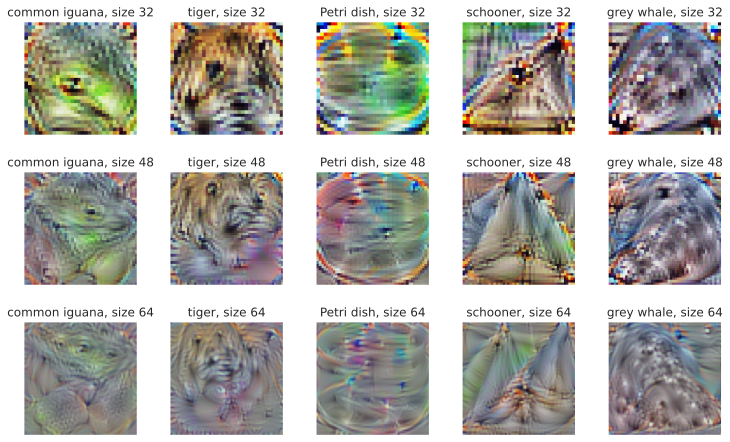

In [ ]:
show_patches(no_rot, patch_sizes)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=no_rot)
show_table_with_rotation(top_1=False, rot_patches=no_rot)

Class pair,Orig 32x32,Orig 48x48,Orig 64x64
common iguana,33.60%,76.59%,89.71%
tiger,29.16%,62.62%,82.90%
Petri dish,8.02%,41.74%,64.37%
schooner,2.13%,37.07%,68.08%
grey whale,0.41%,22.97%,66.17%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64
common iguana,68.58%,96.97%,99.26%
tiger,65.86%,91.89%,98.11%
Petri dish,33.35%,79.23%,92.87%
schooner,13.06%,67.25%,91.78%
grey whale,2.71%,52.56%,90.92%


#### Method 2

In [ ]:
no_rot_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=5, rotation_angles = [0], type="fgsm", file_tem=False)

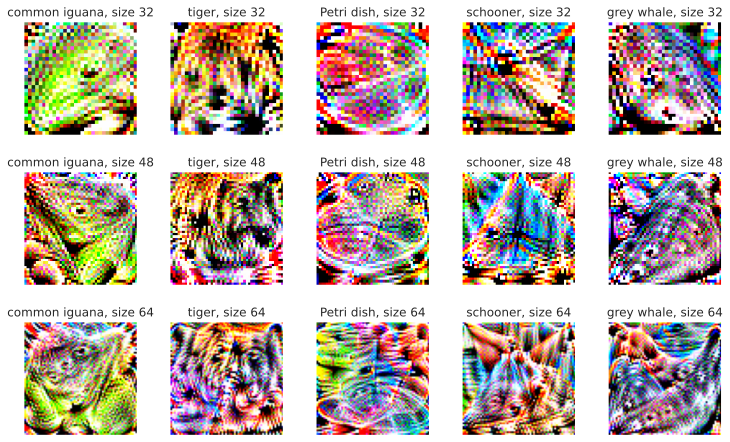

In [ ]:
show_patches(no_rot_fgsm, patch_sizes)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=no_rot_fgsm)
show_table_with_rotation(top_1=False, rot_patches=no_rot_fgsm)

Class pair,Orig 32x32,Orig 48x48,Orig 64x64
common iguana,43.30%,96.14%,99.79%
tiger,29.85%,86.67%,98.85%
Petri dish,8.82%,66.96%,96.81%
schooner,0.50%,67.23%,96.07%
grey whale,0.21%,32.00%,92.34%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64
common iguana,83.21%,99.89%,100.00%
tiger,74.15%,99.05%,99.99%
Petri dish,43.58%,94.46%,99.86%
schooner,11.68%,92.73%,99.82%
grey whale,1.40%,68.25%,99.39%


### Rotations - 90 Degrees

#### Method 1

In [ ]:
rot_90 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=10, rotation_angles = [0, 90], type="normal", file_tem=True)

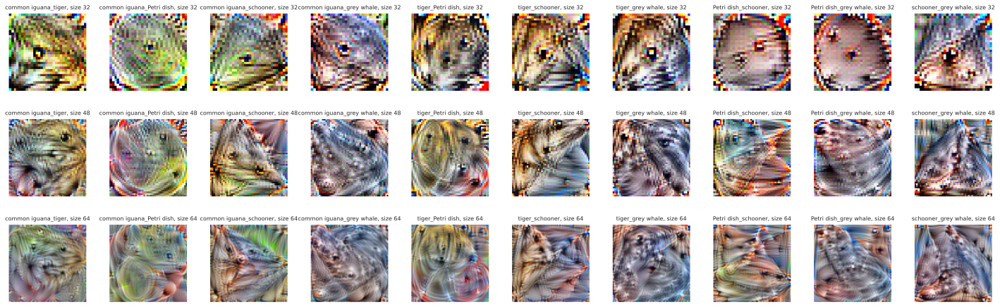

In [ ]:
show_patches(rot_90, patch_sizes, 8)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_90, acc='acc')
show_table_with_rotation(top_1=False, rot_patches=rot_90, acc='acc')

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,16.12%,18.14%,59.53%,66.08%,80.70%,87.93%
common iguana_Petri dish,13.67%,1.17%,47.41%,32.23%,75.97%,80.68%
common iguana_schooner,22.92%,0.25%,47.23%,29.36%,70.32%,73.74%
common iguana_grey whale,19.60%,0.04%,37.14%,20.73%,72.75%,65.87%
tiger_Petri dish,18.94%,0.28%,37.75%,41.45%,64.91%,74.98%
tiger_schooner,13.28%,0.36%,31.99%,28.33%,63.20%,72.82%
tiger_grey whale,16.88%,0.02%,30.81%,11.03%,59.56%,69.00%
Petri dish_schooner,0.40%,0.06%,20.00%,25.04%,46.41%,68.51%
Petri dish_grey whale,0.49%,0.04%,16.38%,10.39%,47.72%,70.06%
schooner_grey whale,2.00%,0.09%,17.00%,4.35%,50.95%,53.81%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,42.90%,47.60%,89.83%,94.65%,97.78%,98.95%
common iguana_Petri dish,39.53%,8.26%,80.45%,80.17%,96.31%,98.19%
common iguana_schooner,52.27%,1.89%,80.73%,59.89%,94.47%,94.28%
common iguana_grey whale,48.67%,0.60%,69.58%,51.86%,94.60%,91.69%
tiger_Petri dish,50.65%,1.75%,74.47%,79.82%,93.18%,96.91%
tiger_schooner,40.99%,4.14%,67.00%,61.64%,90.88%,93.68%
tiger_grey whale,46.86%,0.36%,64.28%,34.52%,88.43%,91.89%
Petri dish_schooner,2.55%,0.73%,49.79%,55.36%,79.86%,91.41%
Petri dish_grey whale,3.14%,0.26%,45.15%,35.24%,82.88%,92.91%
schooner_grey whale,12.10%,0.61%,42.20%,18.31%,80.51%,84.32%


In [ ]:
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['Petri dish', 'schooner'])

Attack with patch rotated on 0°

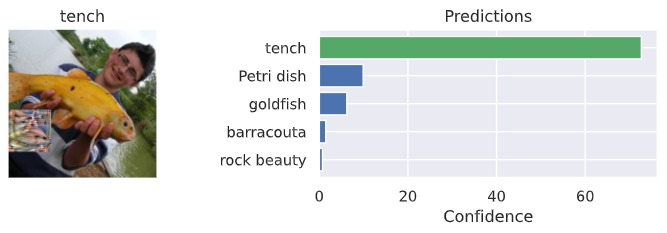

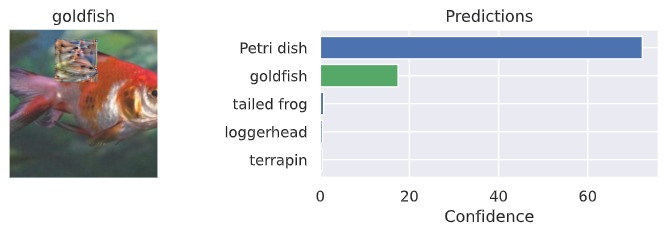

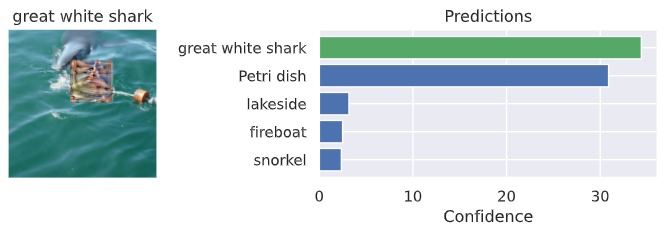

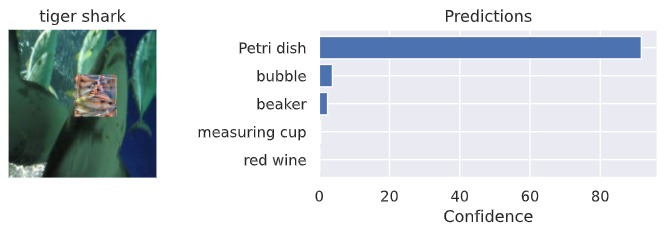

Attack with patch rotated on 90°

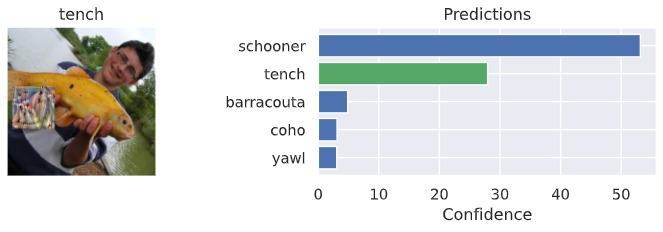

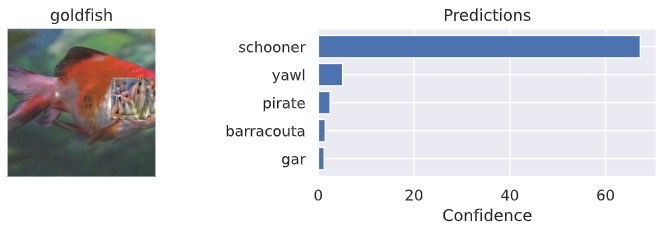

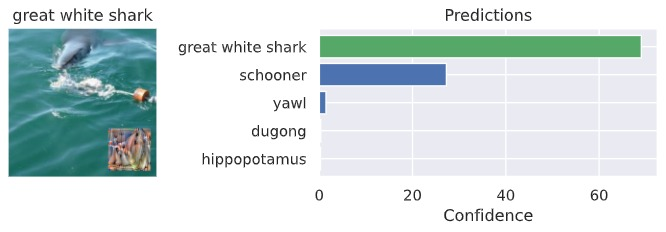

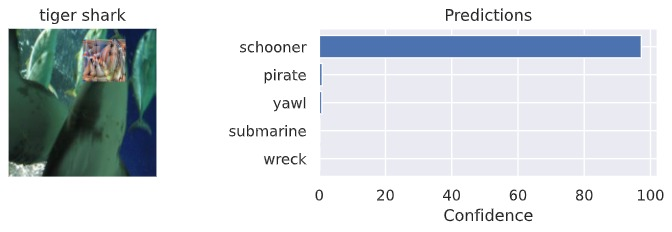

#### Method 2

In [ ]:
rot_1_90_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=10, rotation_angles = [0, 90], type="fgsm", file_tem=True)

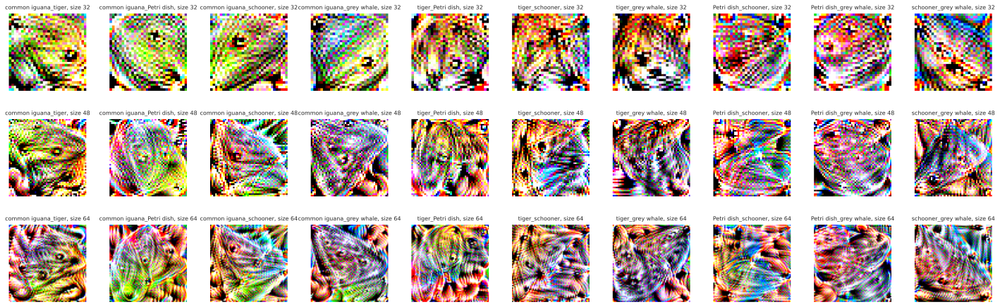

In [ ]:
show_patches(rot_1_90_fgsm, patch_sizes, 8)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_1_90_fgsm, acc='accuracy')
show_table_with_rotation(top_1=False, rot_patches=rot_1_90_fgsm, acc='accuracy')

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,59.23%,61.52%,96.69%,94.22%,99.39%,99.12%
common iguana_Petri dish,41.65%,1.18%,93.77%,83.28%,99.18%,98.68%
common iguana_schooner,45.83%,0.15%,94.55%,76.92%,99.31%,97.97%
common iguana_grey whale,43.12%,0.01%,91.88%,47.62%,98.72%,96.71%
tiger_Petri dish,55.78%,2.05%,88.33%,84.83%,98.31%,98.24%
tiger_schooner,45.95%,0.09%,81.11%,45.01%,97.46%,96.16%
tiger_grey whale,41.92%,0.01%,79.39%,11.20%,97.27%,95.98%
Petri dish_schooner,4.96%,0.06%,75.57%,31.99%,96.32%,95.22%
Petri dish_grey whale,20.29%,0.01%,66.31%,8.63%,94.32%,92.78%
schooner_grey whale,0.09%,0.03%,54.32%,12.90%,93.25%,93.33%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,86.16%,82.50%,99.78%,99.49%,99.99%,99.98%
common iguana_Petri dish,88.08%,6.74%,99.33%,97.29%,99.99%,99.93%
common iguana_schooner,89.80%,1.54%,99.43%,94.25%,99.98%,99.90%
common iguana_grey whale,88.06%,0.14%,98.79%,79.49%,99.95%,99.66%
tiger_Petri dish,87.19%,10.23%,98.54%,97.16%,99.91%,99.94%
tiger_schooner,85.23%,7.72%,98.45%,92.30%,99.90%,99.65%
tiger_grey whale,88.35%,0.09%,98.16%,41.56%,99.78%,99.38%
Petri dish_schooner,59.51%,1.67%,94.40%,88.71%,99.78%,99.54%
Petri dish_grey whale,58.28%,0.09%,92.83%,35.42%,99.57%,98.40%
schooner_grey whale,14.89%,0.16%,88.74%,48.63%,98.95%,98.93%


In [ ]:
patch = rot_1_90_fgsm['common iguana_tiger'][64]['patch']

rot_patches = {}
rot_patches['common iguana (0°)'] = {}
rot_patches['common iguana (0°)'][64] = {}
rot_patches['common iguana (0°)'][64]['patch'] = patch

rotated_patch = TF.rotate(patch, angle=90, expand=False)
rot_patches['tiger (90°)'] = {}
rot_patches['tiger (90°)'][64] = {}
rot_patches['tiger (90°)'][64]['patch'] = rotated_patch


In [ ]:
show_patches(rot_patches, [64], 10)

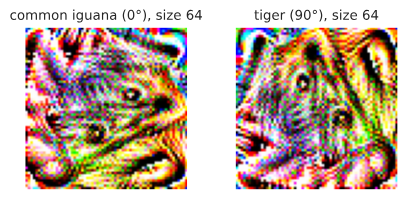

In [ ]:
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['common iguana', 'tiger'])

Attack with patch rotated on 0°

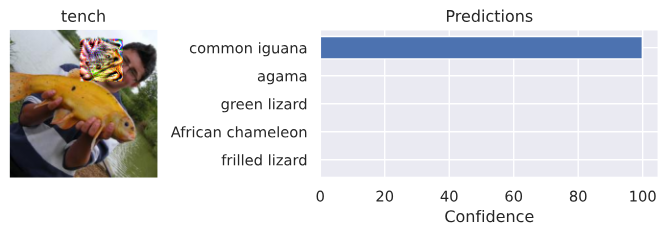

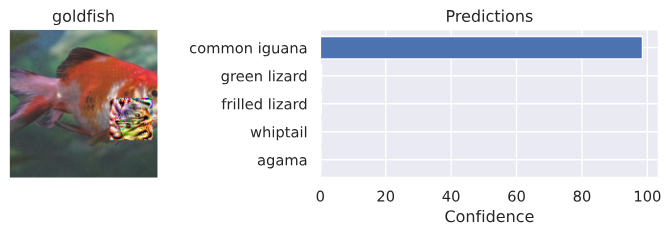

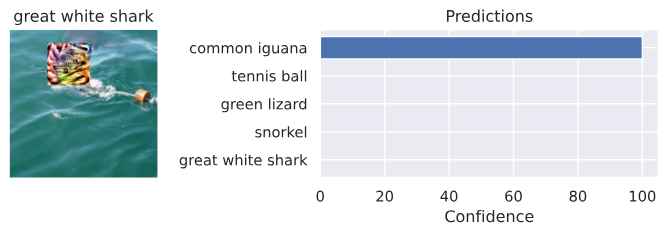

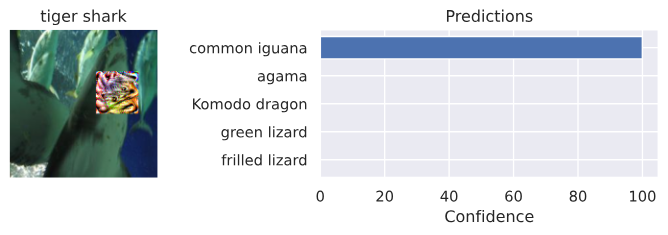

Attack with patch rotated on 90°

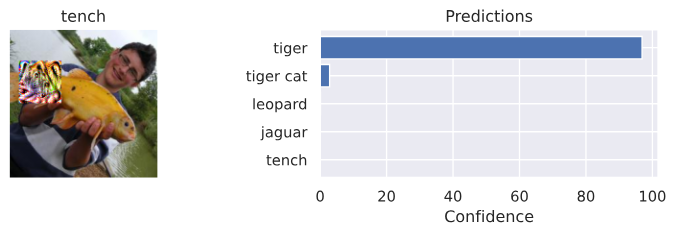

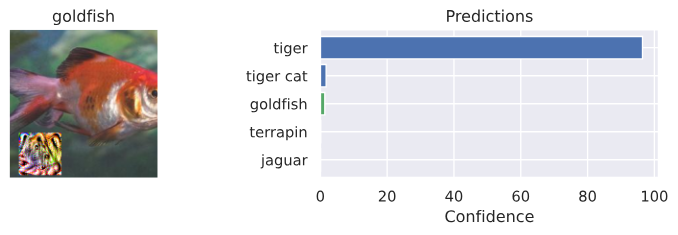

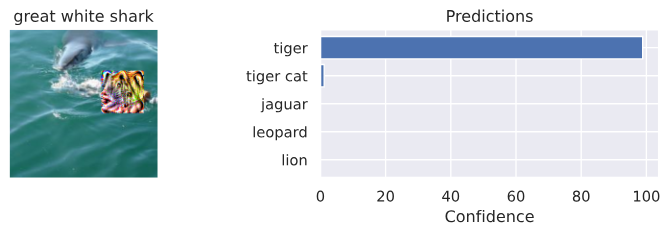

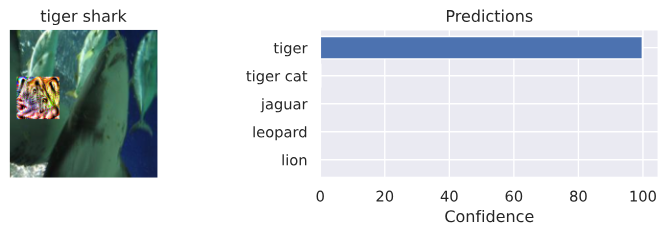

### Rotations - 30 Degrees

#### Method 1

In [ ]:
rot_30 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=10, rotation_angles = [0, 30], type="normal", file_tem=True)

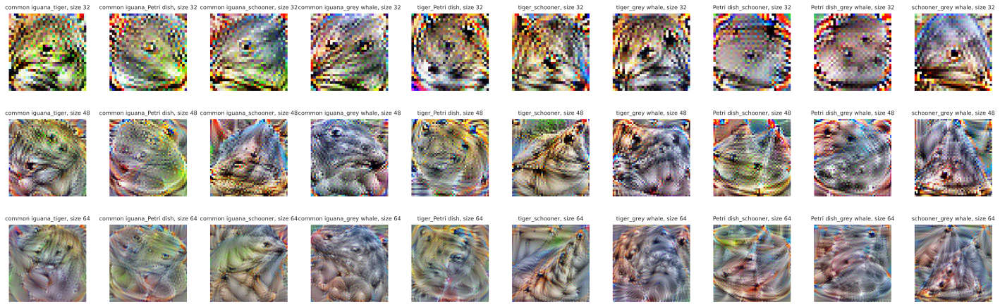

In [ ]:
show_patches(rot_30, patch_sizes, 8)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_30, acc='acc')
show_table_with_rotation(top_1=False, rot_patches=rot_30, acc='acc')

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,69.64%,55.03%,88.17%,88.50%,94.83%,95.68%
common iguana_Petri dish,67.11%,12.43%,85.08%,77.70%,93.46%,92.61%
common iguana_schooner,72.95%,0.32%,84.61%,61.55%,91.68%,88.90%
common iguana_grey whale,66.34%,0.02%,81.36%,49.79%,92.60%,88.63%
tiger_Petri dish,56.01%,0.82%,79.42%,80.25%,91.57%,94.95%
tiger_schooner,56.15%,0.35%,75.61%,60.15%,88.75%,88.61%
tiger_grey whale,61.37%,0.02%,78.51%,59.28%,89.59%,91.49%
Petri dish_schooner,1.87%,0.23%,72.62%,53.15%,85.55%,91.38%
Petri dish_grey whale,2.35%,0.09%,70.77%,63.18%,84.83%,91.13%
schooner_grey whale,3.12%,0.10%,69.98%,47.90%,88.92%,89.28%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,85.51%,83.57%,97.39%,98.11%,99.48%,99.65%
common iguana_Petri dish,84.64%,46.98%,96.09%,95.97%,99.30%,99.24%
common iguana_schooner,88.06%,3.41%,95.48%,87.06%,98.68%,97.19%
common iguana_grey whale,84.55%,0.25%,93.56%,74.99%,98.96%,97.30%
tiger_Petri dish,81.71%,9.06%,93.68%,94.67%,98.76%,99.62%
tiger_schooner,81.46%,23.27%,91.41%,83.04%,97.83%,98.20%
tiger_grey whale,84.56%,0.21%,92.24%,84.60%,97.80%,98.22%
Petri dish_schooner,14.53%,10.17%,86.69%,80.94%,95.29%,98.29%
Petri dish_grey whale,16.11%,0.67%,86.20%,82.44%,95.75%,97.96%
schooner_grey whale,18.09%,1.64%,85.53%,72.92%,97.05%,97.33%


#### Method 2

In [ ]:
rot_1_30_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=10, rotation_angles = [0, 30], type="fgsm", file_tem=True)

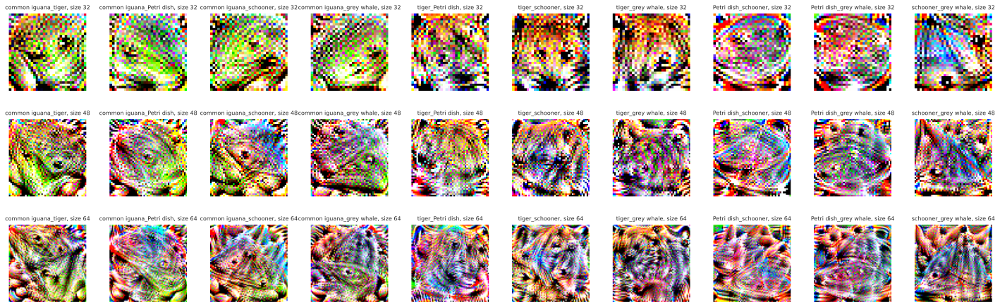

In [ ]:
show_patches(rot_1_30_fgsm, patch_sizes, 8)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_1_30_fgsm, acc='acc')
show_table_with_rotation(top_1=False, rot_patches=rot_1_30_fgsm, acc='acc')

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,54.42%,43.80%,97.65%,94.02%,99.68%,99.08%
common iguana_Petri dish,65.35%,4.12%,96.98%,87.12%,99.75%,98.67%
common iguana_schooner,68.23%,0.13%,96.63%,69.17%,99.51%,97.39%
common iguana_grey whale,66.65%,0.01%,95.81%,52.01%,99.33%,94.54%
tiger_Petri dish,52.46%,5.39%,92.05%,83.87%,98.89%,98.01%
tiger_schooner,60.91%,0.04%,91.16%,29.22%,98.55%,96.13%
tiger_grey whale,49.12%,0.01%,88.68%,50.15%,98.45%,95.43%
Petri dish_schooner,16.00%,0.08%,85.21%,33.89%,97.56%,95.51%
Petri dish_grey whale,21.58%,0.02%,78.57%,35.85%,97.40%,94.48%
schooner_grey whale,0.12%,0.02%,71.62%,30.10%,96.17%,94.59%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger,90.29%,82.52%,99.91%,99.41%,99.99%,99.97%
common iguana_Petri dish,91.34%,67.96%,99.80%,98.24%,100.00%,99.95%
common iguana_schooner,92.75%,9.51%,99.80%,93.99%,99.99%,99.77%
common iguana_grey whale,90.20%,0.18%,99.71%,75.59%,100.00%,99.20%
tiger_Petri dish,87.86%,60.17%,99.30%,97.92%,99.99%,99.93%
tiger_schooner,90.22%,0.36%,99.16%,90.35%,99.93%,99.68%
tiger_grey whale,90.30%,0.16%,98.94%,78.32%,99.96%,99.35%
Petri dish_schooner,70.54%,1.09%,96.09%,91.93%,99.90%,99.49%
Petri dish_grey whale,74.67%,0.22%,96.47%,71.60%,99.90%,99.31%
schooner_grey whale,31.04%,0.13%,91.62%,66.31%,99.52%,99.21%


### 3 Rotations - 0, 30, 90 Degrees

#### Method 1

In [ ]:
rot_0_30_90 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=20, rotation_angles = [0,30,90], type="normal")

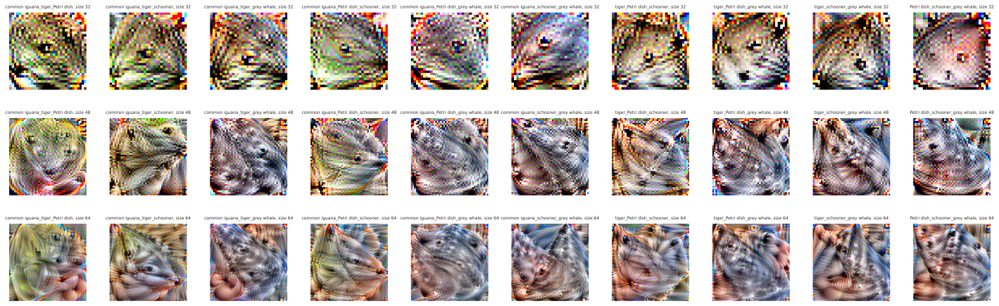

In [ ]:
show_patches(rot_0_30_90, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_0_30_90, acc='acc', rotations=[0, 30, 90])
show_table_with_rotation(top_1=False, rot_patches=rot_0_30_90, acc='acc', rotations=[0, 30, 90])

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish,11.52%,19.37%,0.18%,39.65%,62.07%,28.56%,70.46%,87.97%,82.25%
common iguana_tiger_schooner,17.22%,18.75%,0.19%,40.87%,56.29%,25.22%,70.84%,85.62%,75.46%
common iguana_tiger_grey whale,14.42%,16.51%,0.02%,35.83%,57.16%,13.39%,70.13%,86.58%,74.58%
common iguana_Petri dish_schooner,18.79%,0.53%,0.21%,38.54%,26.58%,26.45%,68.35%,77.63%,72.47%
common iguana_Petri dish_grey whale,13.33%,2.25%,0.04%,34.16%,30.19%,15.64%,68.17%,76.64%,61.68%
common iguana_schooner_grey whale,15.94%,0.17%,0.03%,32.77%,9.29%,8.87%,64.54%,66.03%,62.97%
tiger_Petri dish_schooner,7.05%,0.11%,0.21%,25.08%,38.46%,35.92%,56.78%,81.10%,74.01%
tiger_Petri dish_grey whale,10.71%,0.14%,0.03%,24.03%,35.11%,21.15%,58.70%,79.47%,75.97%
tiger_schooner_grey whale,9.68%,0.20%,0.09%,23.73%,7.85%,11.80%,51.49%,64.45%,69.38%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish,34.89%,51.86%,1.02%,74.37%,93.16%,76.48%,94.50%,99.05%,98.47%
common iguana_tiger_schooner,43.06%,49.14%,1.39%,75.44%,91.73%,53.08%,94.62%,98.88%,95.22%
common iguana_tiger_grey whale,39.17%,44.76%,0.26%,68.53%,92.21%,39.92%,93.97%,98.90%,95.12%
common iguana_Petri dish_schooner,46.23%,3.11%,1.48%,72.46%,77.12%,55.59%,94.02%,97.53%,93.79%
common iguana_Petri dish_grey whale,38.20%,13.33%,0.26%,66.64%,77.74%,42.25%,93.09%,97.90%,87.73%
common iguana_schooner_grey whale,42.29%,1.25%,0.31%,64.98%,35.23%,29.61%,91.16%,92.09%,88.53%
tiger_Petri dish_schooner,27.41%,0.75%,2.60%,56.98%,78.72%,67.31%,87.44%,98.51%,94.19%
tiger_Petri dish_grey whale,37.06%,1.13%,0.25%,57.88%,77.77%,52.24%,88.71%,97.88%,95.04%
tiger_schooner_grey whale,32.68%,2.64%,0.60%,53.53%,40.61%,35.99%,83.99%,90.54%,92.11%


#### Method 2

In [ ]:
rot_0_30_90_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=20, rotation_angles = [0,30,90], type="fgsm")

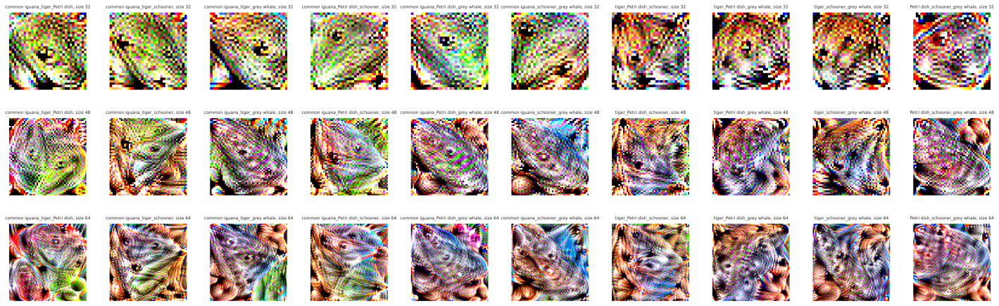

In [ ]:
show_patches(rot_0_30_90_fgsm, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_0_30_90_fgsm, acc='acc', rotations=[0, 30, 90])
show_table_with_rotation(top_1=False, rot_patches=rot_0_30_90_fgsm, acc='acc', rotations=[0, 30, 90])

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish,19.74%,13.89%,0.16%,73.10%,58.87%,39.52%,95.39%,92.60%,90.90%
common iguana_tiger_schooner,16.22%,11.20%,0.16%,72.83%,64.40%,34.77%,95.91%,92.70%,88.21%
common iguana_tiger_grey whale,21.05%,13.61%,0.04%,68.47%,69.64%,7.88%,93.85%,90.79%,82.99%
common iguana_Petri dish_schooner,17.62%,1.14%,0.16%,74.72%,42.51%,32.81%,94.60%,90.67%,88.19%
common iguana_Petri dish_grey whale,21.31%,1.66%,0.02%,64.50%,42.43%,9.76%,93.65%,88.96%,76.67%
common iguana_schooner_grey whale,20.42%,0.29%,0.02%,65.95%,14.66%,10.31%,91.62%,75.55%,77.29%
tiger_Petri dish_schooner,10.35%,1.38%,0.10%,53.53%,44.12%,30.93%,90.25%,88.98%,84.74%
tiger_Petri dish_grey whale,17.78%,0.34%,0.03%,54.06%,38.05%,8.19%,86.74%,84.95%,80.29%
tiger_schooner_grey whale,17.35%,0.06%,0.02%,59.17%,22.71%,0.47%,87.59%,81.79%,81.09%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish,55.02%,46.90%,0.99%,96.09%,93.26%,80.14%,99.85%,99.56%,99.38%
common iguana_tiger_schooner,49.34%,39.53%,1.07%,95.93%,94.00%,67.40%,99.89%,99.58%,98.69%
common iguana_tiger_grey whale,54.28%,46.09%,0.37%,94.50%,95.64%,27.98%,99.63%,99.47%,97.88%
common iguana_Petri dish_schooner,54.60%,7.90%,0.93%,96.66%,83.45%,67.63%,99.79%,99.38%,98.85%
common iguana_Petri dish_grey whale,57.72%,19.78%,0.15%,92.44%,82.31%,30.89%,99.74%,99.31%,96.31%
common iguana_schooner_grey whale,55.70%,4.21%,0.27%,92.64%,68.62%,31.49%,99.57%,96.65%,95.78%
tiger_Petri dish_schooner,39.21%,10.92%,2.03%,89.58%,82.78%,68.27%,99.32%,99.39%,97.85%
tiger_Petri dish_grey whale,54.42%,2.08%,0.18%,89.03%,76.76%,30.16%,98.87%,98.70%,96.33%
tiger_schooner_grey whale,55.63%,1.41%,0.22%,93.11%,66.93%,2.77%,98.96%,97.25%,96.62%


### 4 Rotations - 0, 30, 60, 90 Degrees

#### Method 1

In [ ]:
rot_0_30_60_90 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=20, rotation_angles = [0,30, 60, 90], type="normal")

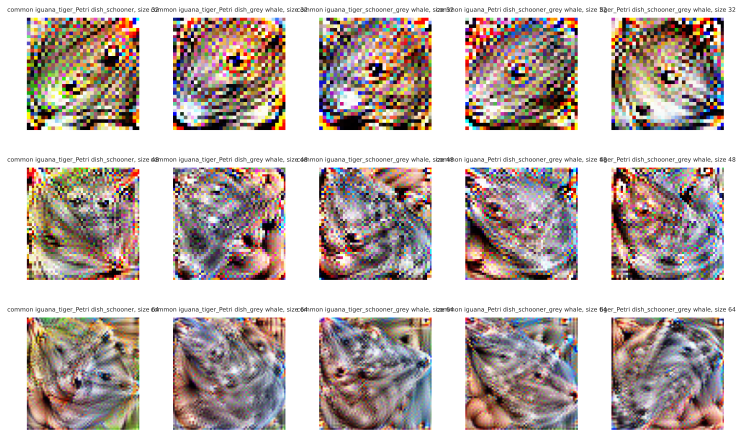

In [ ]:
show_patches(rot_0_30_60_90, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_0_30_60_90, acc='acc', rotations=[0, 30, 60, 90])
show_table_with_rotation(top_1=False, rot_patches=rot_0_30_60_90, acc='acc', rotations=[0, 30, 60, 90])

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,13.32%,14.66%,0.11%,0.14%,33.18%,46.81%,23.78%,15.99%,59.83%,83.48%,71.34%,68.41%
common iguana_tiger_Petri dish_grey whale,8.74%,14.47%,0.06%,0.02%,32.89%,50.68%,24.31%,13.50%,58.25%,80.30%,73.68%,67.37%
common iguana_tiger_schooner_grey whale,12.94%,16.10%,0.11%,0.04%,32.84%,53.33%,12.80%,10.94%,54.87%,80.65%,60.37%,56.23%
common iguana_Petri dish_schooner_grey whale,12.90%,0.19%,0.24%,0.03%,30.07%,27.59%,8.77%,8.30%,56.34%,68.08%,67.56%,62.25%
tiger_Petri dish_schooner_grey whale,3.10%,0.10%,0.27%,0.01%,18.06%,23.62%,5.78%,11.56%,46.79%,66.99%,55.78%,61.46%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,37.11%,43.41%,0.68%,1.24%,66.25%,84.56%,69.62%,39.54%,89.32%,98.47%,96.28%,92.81%
common iguana_tiger_Petri dish_grey whale,29.90%,44.51%,0.70%,0.26%,65.52%,87.25%,71.54%,38.25%,87.95%,97.91%,96.86%,91.84%
common iguana_tiger_schooner_grey whale,36.57%,45.08%,1.79%,0.28%,65.56%,88.92%,48.01%,33.20%,85.60%,97.88%,90.78%,86.02%
common iguana_Petri dish_schooner_grey whale,35.39%,1.17%,3.11%,0.29%,61.49%,72.44%,49.05%,26.24%,86.03%,95.47%,91.62%,89.61%
tiger_Petri dish_schooner_grey whale,16.80%,0.98%,3.65%,0.23%,47.90%,62.62%,40.96%,35.03%,79.02%,95.27%,84.34%,88.30%


#### Method 2

In [ ]:
rot_0_30_60_90_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=20, rotation_angles = [0,30, 60, 90], type="fgsm")

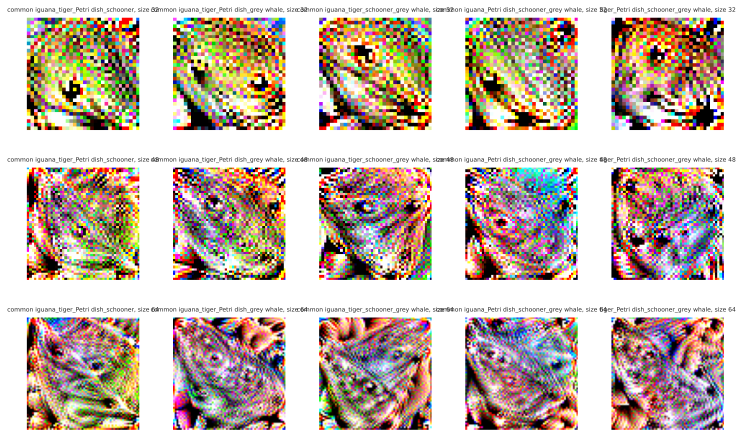

In [ ]:
show_patches(rot_0_30_60_90_fgsm, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_0_30_60_90_fgsm, acc='acc', rotations=[0, 30, 60, 90])
show_table_with_rotation(top_1=False, rot_patches=rot_0_30_60_90_fgsm, acc='acc', rotations=[0, 30, 60, 90])

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,12.98%,9.26%,0.19%,0.16%,69.56%,54.64%,34.19%,11.75%,92.80%,89.59%,84.88%,81.09%
common iguana_tiger_Petri dish_grey whale,9.08%,10.11%,0.11%,0.02%,67.57%,57.53%,41.58%,0.21%,90.65%,85.97%,83.54%,74.32%
common iguana_tiger_schooner_grey whale,12.91%,9.61%,0.21%,0.00%,58.77%,50.06%,22.30%,0.96%,88.23%,84.97%,72.91%,65.28%
common iguana_Petri dish_schooner_grey whale,15.15%,0.38%,0.24%,0.02%,63.50%,35.40%,16.53%,2.72%,87.60%,77.13%,73.20%,63.39%
tiger_Petri dish_schooner_grey whale,15.67%,0.19%,0.06%,0.02%,44.58%,34.93%,5.86%,0.38%,82.35%,80.54%,71.84%,71.73%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,42.65%,32.51%,1.19%,1.00%,94.83%,89.65%,76.51%,47.97%,99.71%,99.36%,98.73%,97.47%
common iguana_tiger_Petri dish_grey whale,38.26%,36.46%,0.89%,0.25%,94.18%,91.21%,80.51%,1.51%,99.52%,98.98%,98.58%,94.84%
common iguana_tiger_schooner_grey whale,44.47%,35.96%,2.53%,0.19%,91.38%,89.42%,63.83%,5.30%,99.26%,98.67%,94.45%,89.90%
common iguana_Petri dish_schooner_grey whale,44.13%,2.30%,4.83%,0.16%,91.39%,78.41%,59.10%,12.35%,99.08%,97.41%,94.40%,90.45%
tiger_Petri dish_schooner_grey whale,49.22%,1.48%,0.51%,0.19%,83.66%,71.68%,43.02%,2.54%,98.18%,98.15%,93.93%,93.95%


### 4 Rotations - 0, 90, 180, 270 Degrees

#### Method 1

In [ ]:
rot_0_90_180_270 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=20, rotation_angles = [0, 90, 180, 270], type="normal")

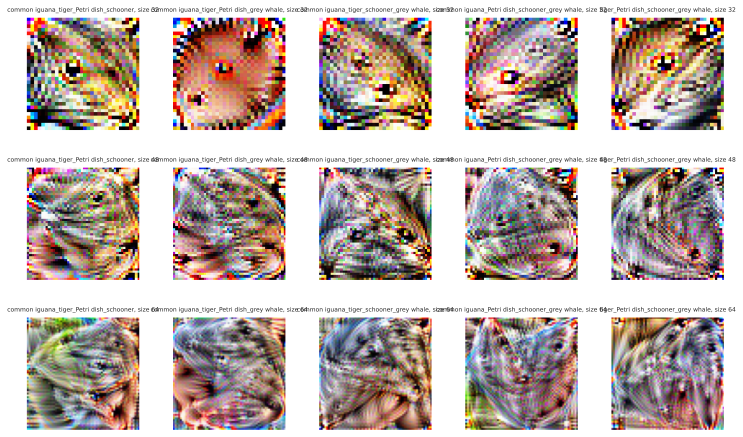

In [ ]:
show_patches(rot_0_90_180_270, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_0_90_180_270, acc='acc', rotations=[0, 90, 180, 270])
show_table_with_rotation(top_1=False, rot_patches=rot_0_90_180_270, acc='acc', rotations=[0, 90, 180, 270])

,Rot 0°,Rot 0°,Rot 0°,Rot 90°,Rot 90°,Rot 90°,Rot 180°,Rot 180°,Rot 180°,Rot 270°,Rot 270°,Rot 270°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,12.13%,13.04%,0.06%,0.11%,30.73%,42.79%,14.50%,6.59%,52.66%,69.98%,70.25%,60.11%
common iguana_tiger_Petri dish_grey whale,0.03%,0.01%,0.23%,0.02%,33.57%,43.72%,10.69%,0.17%,57.60%,73.37%,62.98%,62.28%
common iguana_tiger_schooner_grey whale,12.30%,8.10%,0.12%,0.03%,28.67%,39.53%,2.99%,0.98%,47.44%,65.35%,33.47%,42.20%
common iguana_Petri dish_schooner_grey whale,11.90%,0.07%,0.16%,0.05%,35.07%,6.90%,0.15%,0.54%,40.85%,40.13%,27.50%,36.04%
tiger_Petri dish_schooner_grey whale,1.84%,0.07%,0.09%,0.03%,20.73%,3.76%,2.94%,2.66%,34.42%,45.31%,40.51%,48.04%


,Rot 0°,Rot 0°,Rot 0°,Rot 90°,Rot 90°,Rot 90°,Rot 180°,Rot 180°,Rot 180°,Rot 270°,Rot 270°,Rot 270°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,33.77%,38.00%,0.38%,0.86%,64.22%,80.19%,51.59%,21.71%,84.37%,95.28%,95.26%,88.53%
common iguana_tiger_Petri dish_grey whale,0.28%,0.40%,1.30%,0.20%,67.19%,79.27%,43.37%,1.73%,87.23%,95.31%,92.42%,88.07%
common iguana_tiger_schooner_grey whale,34.06%,28.29%,0.96%,0.25%,60.38%,78.76%,15.54%,6.28%,80.56%,95.41%,63.10%,74.57%
common iguana_Petri dish_schooner_grey whale,34.67%,0.39%,1.28%,0.31%,67.55%,41.70%,1.28%,3.44%,74.24%,81.24%,55.88%,69.24%
tiger_Petri dish_schooner_grey whale,12.02%,0.51%,0.85%,0.28%,49.08%,16.42%,12.21%,13.23%,66.25%,79.10%,70.85%,79.79%


#### Method 2

In [ ]:
rot_0_90_180_270_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=20, rotation_angles = [0, 90, 180, 270], type="fgsm")

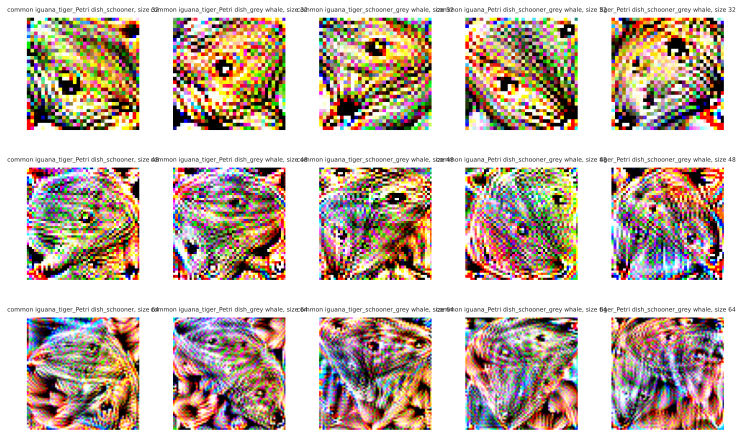

In [ ]:
show_patches(rot_0_90_180_270_fgsm, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_0_90_180_270_fgsm, acc='acc', rotations=[0, 90, 180, 270])
show_table_with_rotation(top_1=False, rot_patches=rot_0_90_180_270_fgsm, acc='acc', rotations=[0, 90, 180, 270])

,Rot 0°,Rot 0°,Rot 0°,Rot 90°,Rot 90°,Rot 90°,Rot 180°,Rot 180°,Rot 180°,Rot 270°,Rot 270°,Rot 270°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,13.28%,13.64%,0.08%,0.11%,61.16%,41.77%,23.22%,5.14%,92.26%,82.89%,78.47%,73.66%
common iguana_tiger_Petri dish_grey whale,15.88%,2.05%,0.07%,0.01%,65.26%,45.77%,24.10%,0.10%,87.43%,80.14%,71.19%,70.49%
common iguana_tiger_schooner_grey whale,14.38%,5.62%,0.14%,0.02%,56.33%,52.45%,13.96%,0.11%,80.78%,76.27%,59.16%,41.15%
common iguana_Petri dish_schooner_grey whale,16.92%,0.07%,0.15%,0.02%,58.67%,16.93%,0.55%,0.08%,84.03%,59.39%,56.13%,48.27%
tiger_Petri dish_schooner_grey whale,9.15%,0.08%,0.09%,0.03%,41.51%,16.61%,0.71%,0.48%,68.79%,49.14%,59.91%,36.68%


,Rot 0°,Rot 0°,Rot 0°,Rot 90°,Rot 90°,Rot 90°,Rot 180°,Rot 180°,Rot 180°,Rot 270°,Rot 270°,Rot 270°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
common iguana_tiger_Petri dish_schooner,41.17%,42.20%,0.60%,0.61%,90.63%,82.61%,62.01%,23.58%,99.72%,98.69%,97.23%,93.96%
common iguana_tiger_Petri dish_grey whale,45.55%,19.96%,0.41%,0.19%,93.24%,87.99%,70.96%,0.75%,98.93%,97.79%,96.91%,92.31%
common iguana_tiger_schooner_grey whale,43.61%,25.25%,1.19%,0.23%,88.33%,89.06%,42.28%,1.03%,98.23%,96.78%,87.43%,72.37%
common iguana_Petri dish_schooner_grey whale,47.06%,0.49%,1.17%,0.32%,88.84%,53.59%,3.89%,0.45%,98.61%,92.03%,84.09%,79.85%
tiger_Petri dish_schooner_grey whale,35.18%,0.40%,0.73%,0.20%,81.54%,59.92%,8.71%,3.06%,93.86%,90.38%,86.75%,69.26%


### 12 Rotations

In [ ]:
rot_12 = [i * 30 for i in range(12)]

In [ ]:
class_names =  ['minibus', 'slug', 'European fire salamander', 'reflex camera', 'tabby', 'Siberian husky', 'komondor', 'dowitcher', 'radio', 'wallaby', 'packet', 'reel']

#### Method 1

In [ ]:
rot_12 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=20, rotation_angles = rot_12, type="normal")

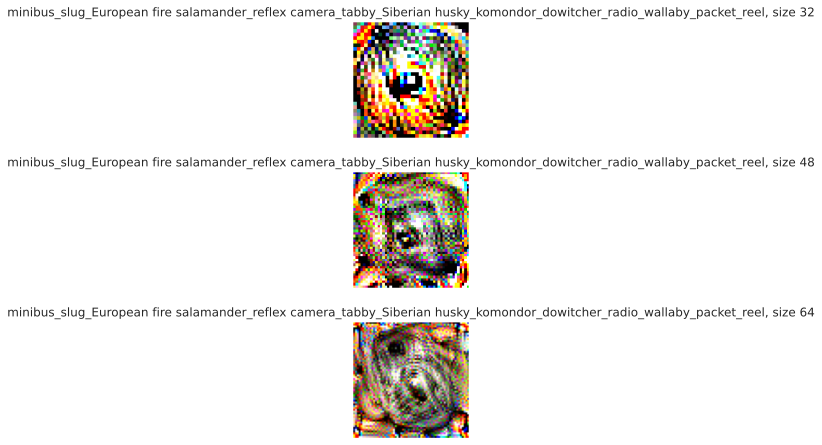

In [ ]:
show_patches(rot_12, patch_sizes, 12)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_12, acc='acc', rotations=rot_12)
show_table_with_rotation(top_1=False, rot_patches=rot_12, acc='acc', rotations=rot_12)

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.00%,0.00%,0.05%,0.01%,0.01%,0.15%,0.02%,0.01%,0.04%,0.01%,0.00%,0.73%,0.02%,0.01%,0.93%,0.01%,0.03%,0.07%,0.02%,0.01%,0.15%,0.01%,0.05%,4.31%,0.02%,0.01%,1.92%,0.01%,0.01%,0.09%,0.02%,0.00%,0.21%,0.01%,0.04%,5.16%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.36%,0.03%,1.96%,0.21%,0.17%,0.57%,0.20%,0.13%,0.71%,0.30%,0.20%,6.67%,0.61%,0.28%,8.34%,0.37%,0.35%,0.57%,0.11%,0.30%,1.13%,0.23%,0.35%,20.92%,0.48%,0.14%,14.22%,0.50%,0.21%,0.51%,0.16%,0.16%,1.83%,0.18%,0.45%,21.64%


#### Method 2

In [ ]:
rot_12_fgsm = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=20, rotation_angles = rot_12, type="fgsm")

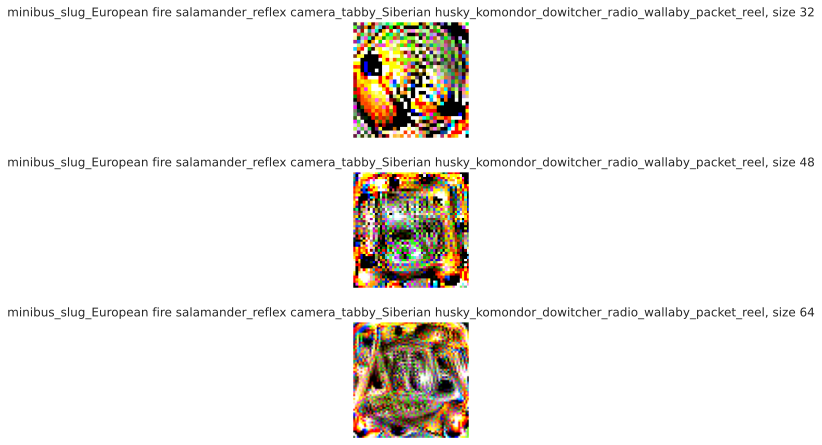

In [ ]:
show_patches(rot_12_fgsm, patch_sizes, 12)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=rot_12_fgsm, acc='acc', rotations=rot_12)
show_table_with_rotation(top_1=False, rot_patches=rot_12_fgsm, acc='acc', rotations=rot_12)

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°,Rot 120°,Rot 120°,Rot 120°,Rot 150°,Rot 150°,Rot 150°,Rot 180°,Rot 180°,Rot 180°,Rot 210°,Rot 210°,Rot 210°,Rot 240°,Rot 240°,Rot 240°,Rot 270°,Rot 270°,Rot 270°,Rot 300°,Rot 300°,Rot 300°,Rot 330°,Rot 330°,Rot 330°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.02%,0.00%,5.36%,0.01%,0.00%,0.15%,0.02%,0.00%,0.06%,0.02%,0.04%,0.91%,14.02%,0.00%,49.22%,21.25%,0.01%,0.06%,0.03%,0.11%,0.83%,0.00%,1.30%,54.55%,50.28%,11.16%,57.40%,52.14%,23.80%,0.03%,0.07%,56.68%,29.89%,0.01%,23.00%,72.73%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°,Rot 120°,Rot 120°,Rot 120°,Rot 150°,Rot 150°,Rot 150°,Rot 180°,Rot 180°,Rot 180°,Rot 210°,Rot 210°,Rot 210°,Rot 240°,Rot 240°,Rot 240°,Rot 270°,Rot 270°,Rot 270°,Rot 300°,Rot 300°,Rot 300°,Rot 330°,Rot 330°,Rot 330°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.47%,0.11%,24.59%,0.16%,0.21%,0.61%,0.19%,0.29%,0.91%,0.13%,0.36%,6.78%,40.76%,0.27%,80.90%,58.04%,0.22%,0.45%,0.36%,0.60%,7.40%,0.08%,7.96%,88.70%,81.16%,41.47%,88.45%,84.82%,68.26%,0.32%,0.93%,87.15%,68.72%,0.27%,54.78%,95.82%


## Results

**No Rotations (Baseline)**

---

In the baseline experiments with no rotations, an increase in patch size from 32×32 to 64×64 leads to a significant improvement in attack effectiveness for both method1 and method2. For example, class pairs such as "common iguana" and "tiger" demonstrate much higher top1 and top5 accuracies when larger patches are used, underscoring the importance of patch size in enhancing performance. Moreover, method 2 consistently achieves higher performance levels, with its top1 and top5 metrics often approaching or reaching 100% for larger patches. This suggests that, in the absence of rotations, method 2 is capable of producing more potent adversarial patches compared to method 1.









**2 Rotations (0° \ 90° or 0° \ 30°)**

---

In the example below, we can see how the same patch looks in different rotation.




Method 1:

In [ ]:
patch = rot_90['Petri dish_schooner'][64]['patch']

rot_patches = {}
rot_patches['petri dish (0°)'] = {}
rot_patches['petri dish (0°)'][64] = {}
rot_patches['petri dish (0°)'][64]['patch'] = patch

rotated_patch = TF.rotate(patch, angle=90, expand=False)
rot_patches['schooner (90°)'] = {}
rot_patches['schooner (90°)'][64] = {}
rot_patches['schooner (90°)'][64]['patch'] = rotated_patch


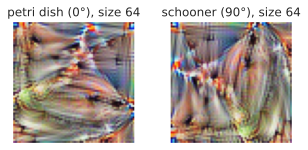

In [ ]:
show_patches(rot_patches, [64], txt_size=12)

Method 2:

In [ ]:
patch = rot_1_90_fgsm['Petri dish_schoner'][64]['patch']

rot_patches = {}
rot_patches['petri dish (0°)'] = {}
rot_patches['petri dish (0°)'][64] = {}
rot_patches['petri dish (0°)'][64]['patch'] = patch

rotated_patch = TF.rotate(patch, angle=90, expand=False)
rot_patches['schooner (90°)'] = {}
rot_patches['schooner (90°)'][64] = {}
rot_patches['schooner (90°)'][64]['patch'] = rotated_patch


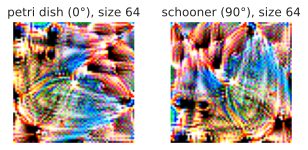

In [ ]:
show_patches(rot_patches, [64], txt_size=12)

Now, we can see the results of the attack using all patch sizes & use the 2 rotations of patches.

Method 1:

32 X 32

petri dish


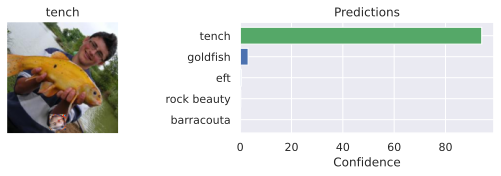

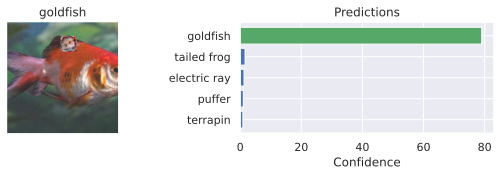

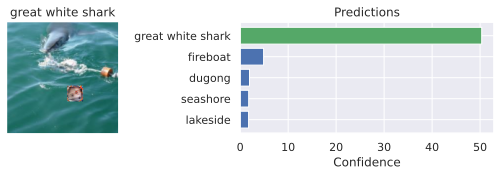

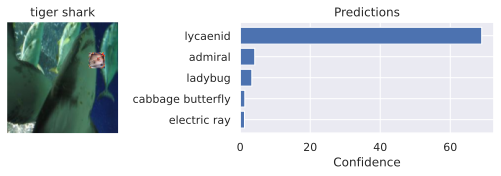

schooner


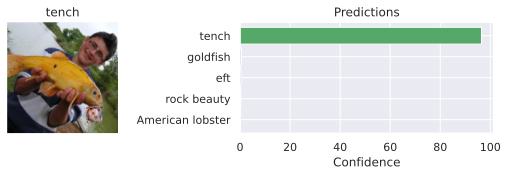

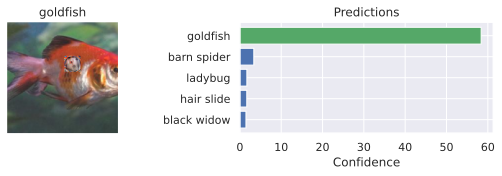

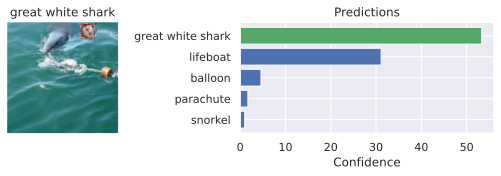

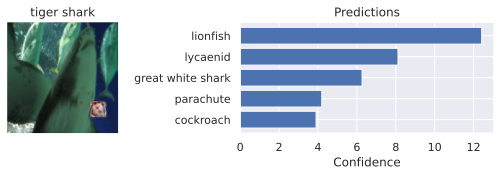

In [ ]:
patch = rot_90['common iguana_tiger'][32]['patch']
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['petri dish', 'schooner'])

48X48

petri dish


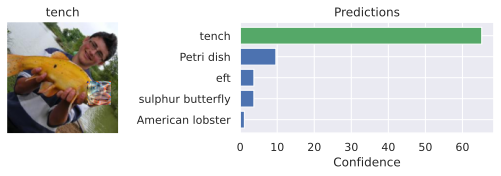

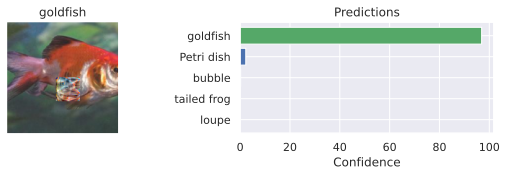

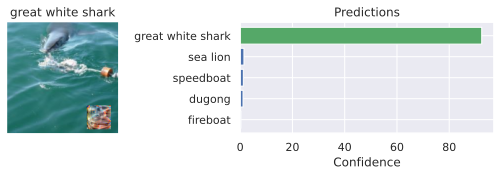

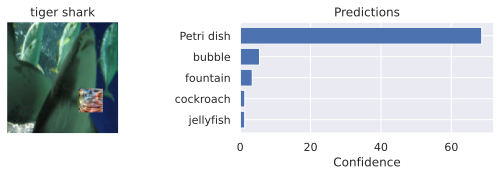

schooner


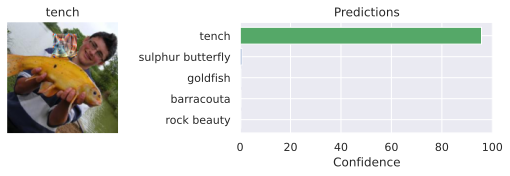

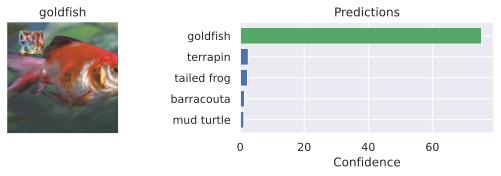

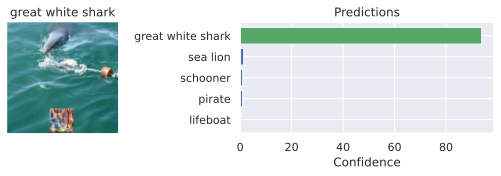

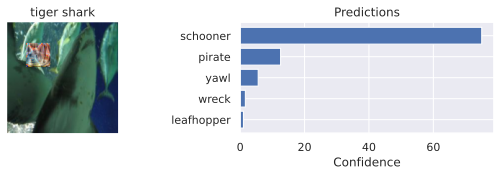

In [ ]:
patch = rot_90['common iguana_tiger'][48]['patch']
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['petri dish', 'schooner'])

64 X 64

petri dish


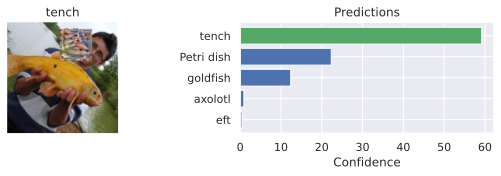

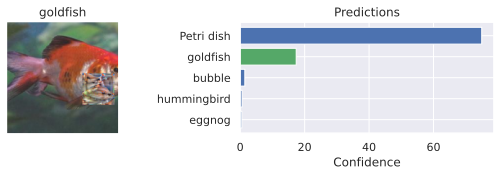

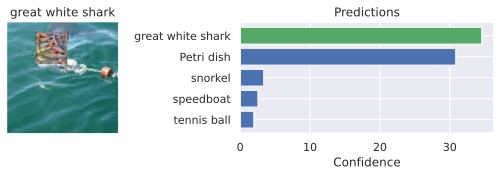

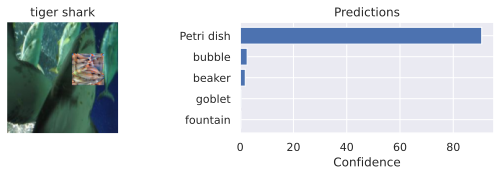

schooner


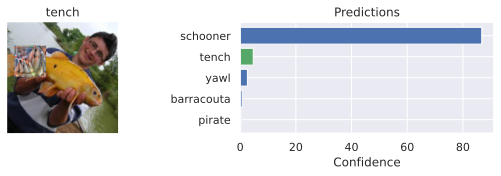

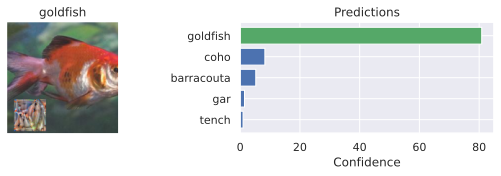

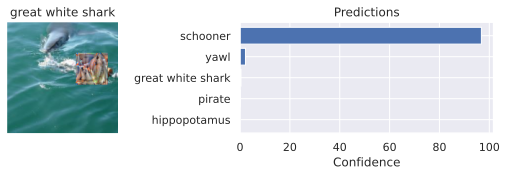

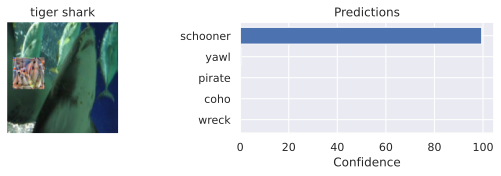

In [ ]:
patch = rot_90['common iguana_tiger'][64]['patch']
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['petri dish', 'schooner'])

Method 2:

32 X 32

petri dish


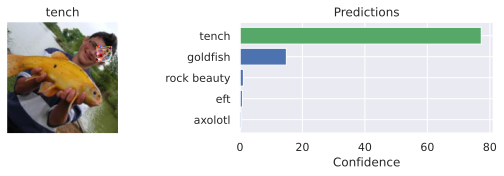

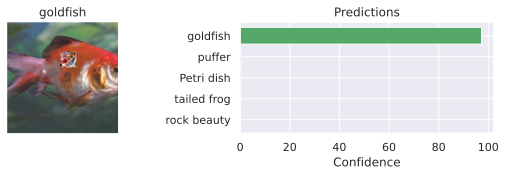

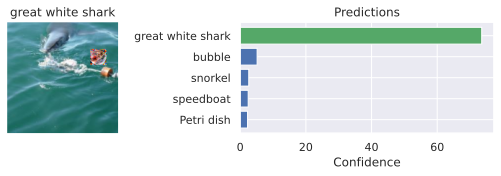

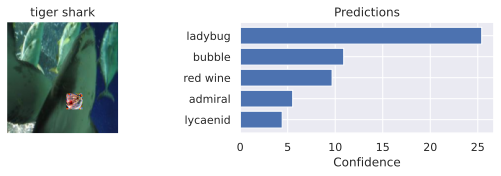

schooner


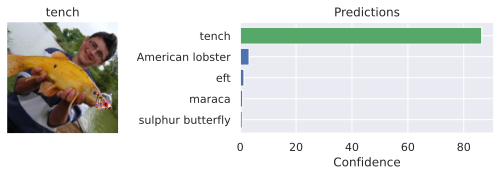

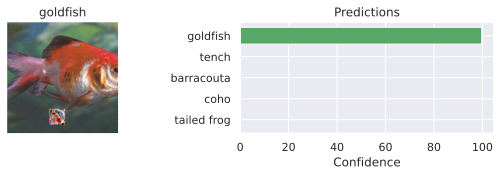

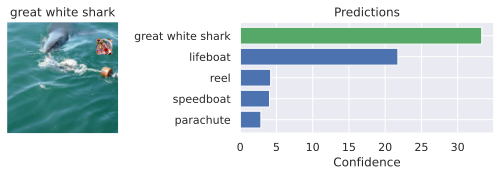

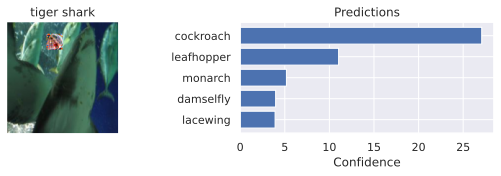

In [ ]:
patch = rot_1_90_fgsm['Petri dish_schooner'][32]['patch']
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['petri dish', 'schooner'])

48 X 48

petri dish


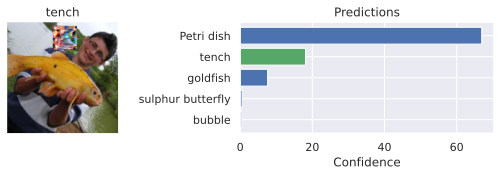

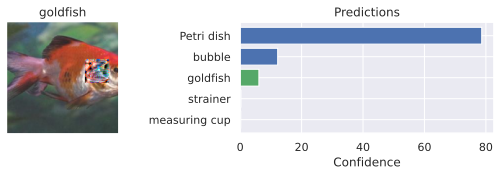

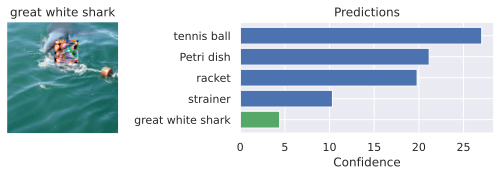

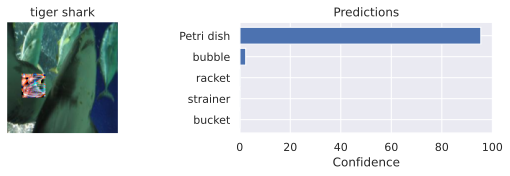

schooner


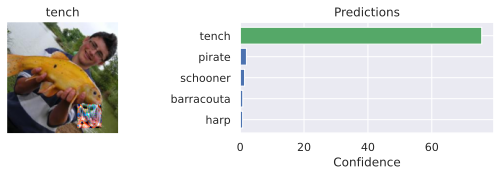

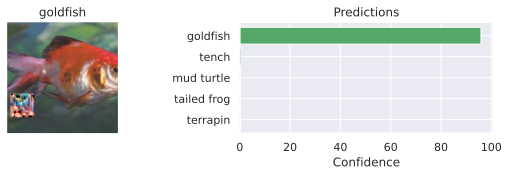

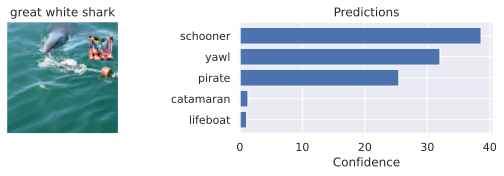

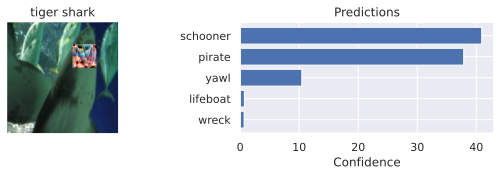

In [ ]:
patch = rot_1_90_fgsm['Petri dish_schooner'][48]['patch']
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['petri dish', 'schooner'])

64 X 64

petri dish


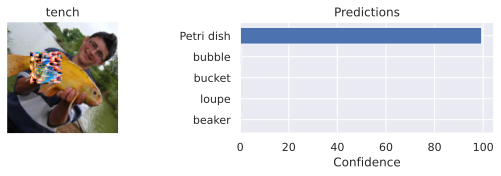

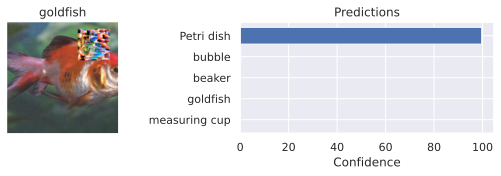

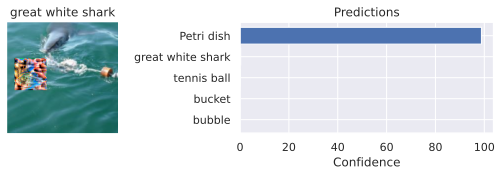

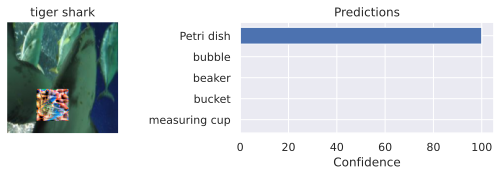

schooner


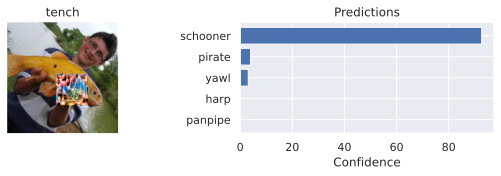

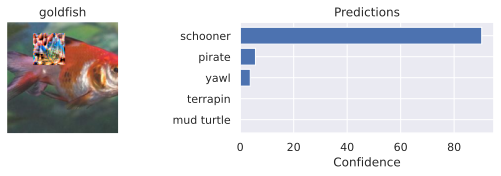

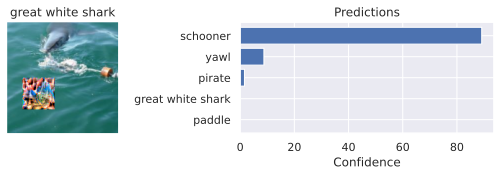

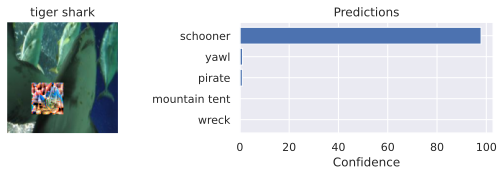

In [ ]:
patch = rot_1_90_fgsm['Petri dish_schooner'][64]['patch']
perform_patch_attack(patch, circle = False, rotations=[0, 90], target=['petri dish', 'schooner'])

Our experimental results reveal significant patterns in the effectiveness of rotated adversarial patches across different configurations. The analysis demonstrates a clear correlation between patch size and attack success rates, with 64x64 patches consistently outperforming smaller dimensions (32x32 and 48x48) across all experimental setups. Method 2 exhibited notably superior performance, achieving Top-1 accuracy rates exceeding 90% and Top-5 accuracy approaching 99% with 64x64 patches, substantially outperforming Method 1's results. Visual inspection of the generated patches provides additional support for these numerical findings - smaller patches displayed limited capability in generating effective adversarial patterns, while Method 1 struggled to consistently attack both target classes even with larger patches. In contrast, Method 2 successfully generated effective adversarial patterns for both target classes at 64x64 size. When comparing rotation angles, patches rotated at 90° generally showed marginally better performance than those at 30°, though this difference became less pronounced with larger patch sizes. These results collectively emphasize the crucial role of patch size in multi-rotation adversarial attacks and highlight Method 2's superior approach to patch generation.


**3 Rotations (0° \ 30° \ 90)**

For the three-rotation setup (0°, 30°, 90°), both Method 1 and Method 2 show that when the patch is not  rotated, (at resolutions 32×32, 48×48, 64×64) yield very low recognition rates, particularly at the highest resolution (64×64). When rotated images are considered—especially those rotated at 90°—there is a significant improvement in performance. In Method 1, Top1 percentages can reach 80–90% in some cases, while Method 2 exhibits a similar trend with somewhat lower Top1 values but considerably improved Top5 scores, often approaching or exceeding 90%. The performance also varies depending on the specific class pairs being compared.

---

**4 Rotations (0° \ 30° \ 60° \ 90°)**

Both experiments—with rotations of (0°, 30°, 60°, 90°) and (0°, 90°, 180°, 270°)—demonstrate a consistent overall trend. In each case, the original images yield low recognition rates, while introducing rotated images markedly improves performance. This suggests that the inclusion of rotated data, regardless of the specific angles chosen, is highly beneficial for enhancing recognition accuracy.

---

**12 Rotations**

Finally, the twelve-rotation setup, which involves a more complex multi-class arrangement, indicates that the challenging nature of some class groups leads to very low baseline recognition rates on original images. In Method 1, although some rotations result in modest improvements (with increases from near 0% to around 4–5% in specific cases), the overall performance remains low compared to simpler setups. Method 2 shows a similar overall trend, with some rotations producing dramatic increases in Top5 performance—sometimes reaching 70–80%—but also with high variability across different angles.



---


In [ ]:
import pandas as pd
import plotly.express as px

# Define constants
method1_color = '#553E56'  # (85, 62, 86)
method2_color = '#3494BA'  # (52, 148, 186)
custom_palette = {"Method 1": method1_color, "Method 2": method2_color}

# Create the data
data_list = []
rotations = [
    "No Rotations", "1 Rotation (0°,30°)", "1 Rotation (0°,90°)",
    "2 Rotations", "3 Rotations (0°-90°)", "3 Rotations (0°-270°)", "12 Rotations"
]
patch_sizes = ["32x32", "48x48", "64x64"]

# Restructure the data for plotly
for rotation in rotations:
    for method in [1, 2]:
        for patch in patch_sizes:
            if patch == "32x32":
                val = {
                    "Rotation": rotation,
                    "Method": f"Method {method}",
                    "Patch Size": patch,
                    "Performance": [14.66, 19.66, 54.92, 34.73, 25.31, 18.19, 0.01][rotations.index(rotation)] if method == 1 else [16.54, 42.77, 51.01, 55.67, 30.23, 24.07, 11.49][rotations.index(rotation)]
                }
            elif patch == "48x48":
                val = {
                    "Rotation": rotation,
                    "Method": f"Method {method}",
                    "Patch Size": patch,
                    "Performance": [48.20, 32.65, 48.56, 38.86, 29.08, 20.79, 0.02][rotations.index(rotation)] if method == 1 else [69.80, 51.93, 51.95, 43.56, 36.80, 31.76, 31.81][rotations.index(rotation)]
                }
            else:  # 64x64
                val = {
                    "Rotation": rotation,
                    "Method": f"Method {method}",
                    "Patch Size": patch,
                    "Performance": [74.25, 53.13, 84.94, 30.25, 39.73, 30.95, 1.15][rotations.index(rotation)] if method == 1 else [96.77, 89.31, 92.91, 33.55, 51.54, 42.88, 22.60][rotations.index(rotation)]
                }
            data_list.append(val)

# Create DataFrame
df = pd.DataFrame(data_list)

# Create the grouped bar plot
fig = px.bar(
    df,
    x="Rotation",
    y="Performance",
    color="Method",
    barmode="group",
    color_discrete_map=custom_palette,
    text_auto='.1f',
    title='Average Top1 Performance by Rotation Type and Method',
    labels={"Performance": "Top1 Accuracy (%)", "Rotation": "Rotation Type"},
    custom_data=["Patch Size"],  # Add Patch Size to hover data
)

# Customize the hover template
fig.update_traces(
    hovertemplate="<b>Rotation:</b> %{x}<br>" +
                  "<b>Method:</b> %{fullData.name}<br>" +
                  "<b>Performance:</b> %{y:.1f}%<br>" +
                  "<b>Patch Size:</b> %{customdata[0]}<br>" +
                  "<extra></extra>",  # Remove extra hover info
    textfont_size=14,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
)

# Customize the plot layout
fig.update_layout(
    xaxis_title="Rotation Type",
    yaxis_title="Top1 Accuracy (%)",
    legend_title="Method",
    font=dict(size=14),
    xaxis=dict(tickangle=45),
    title_font_size=16,
    height=600,
    width=1200,
)

# Show the plot
fig.show()

## Circle Patch

In [ ]:
class_names =  ['forklift', 'monarch', 'limpkin', 'gasmask', 'plastic bag']
patch_sizes = [32, 48, 64]

### No Rotations

#### Method 1

In [ ]:
circle_lab = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=5, rotation_angles = [0], type="normal", circle = True)

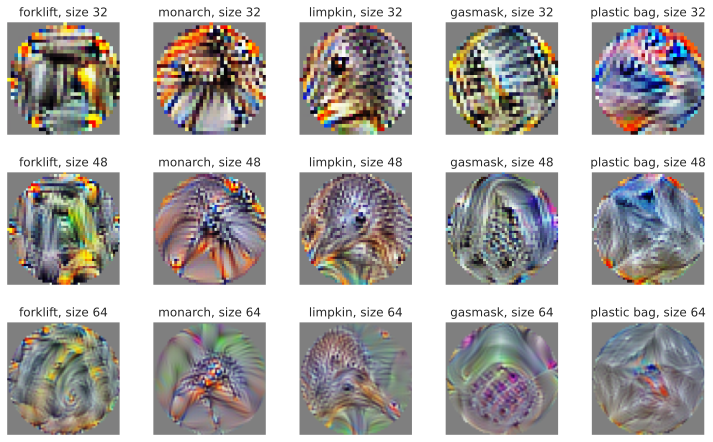

In [ ]:
show_patches(circle_lab, patch_sizes, 12)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_lab, acc='acc')
show_table_with_rotation(top_1=False, rot_patches=circle_lab, acc='acc')

Class pair,Orig 32x32,Orig 48x48,Orig 64x64
forklift,0.48%,12.49%,19.75%
monarch,23.61%,36.53%,46.71%
limpkin,11.90%,39.95%,63.43%
gasmask,0.67%,7.08%,43.48%
plastic bag,0.27%,26.21%,46.18%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64
forklift,3.86%,33.44%,46.80%
monarch,54.13%,69.11%,79.38%
limpkin,33.03%,72.24%,89.06%
gasmask,8.65%,34.66%,81.51%
plastic bag,2.59%,56.68%,80.65%


#### Method 2

In [ ]:
circle = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=5, rotation_angles = [0], type="f_circle_5epochs_fgsm", circle = True)

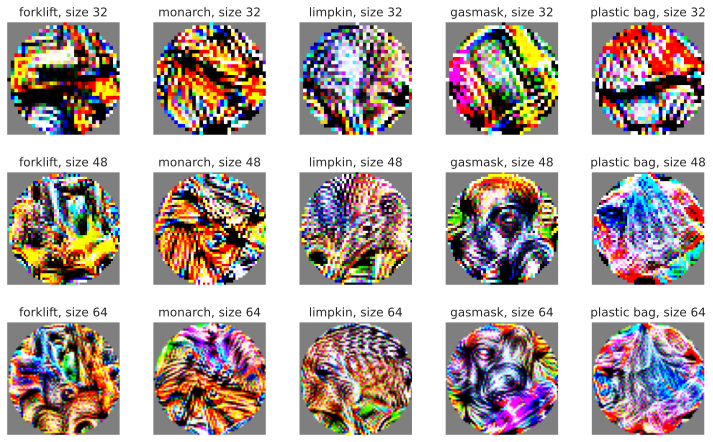

In [ ]:
show_patches(circle, patch_sizes, 12)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle, acc='acc', rotations=[0])
show_table_with_rotation(top_1=False, rot_patches=circle, acc='acc', rotations=[0])

Class pair,Orig 32x32,Orig 48x48,Orig 64x64
forklift,1.10%,73.12%,99.07%
monarch,77.39%,98.19%,99.84%
limpkin,28.88%,86.36%,98.58%
gasmask,14.18%,98.31%,99.97%
plastic bag,1.71%,83.82%,99.28%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64
forklift,8.81%,94.11%,99.97%
monarch,97.50%,99.98%,100.00%
limpkin,58.72%,98.41%,99.94%
gasmask,46.42%,99.96%,100.00%
plastic bag,20.47%,98.81%,99.99%


### Rotations: 30 Degrees

#### Method 1

In [ ]:
circle_original = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=10, rotation_angles = [0, 30], type="new", circle = True)

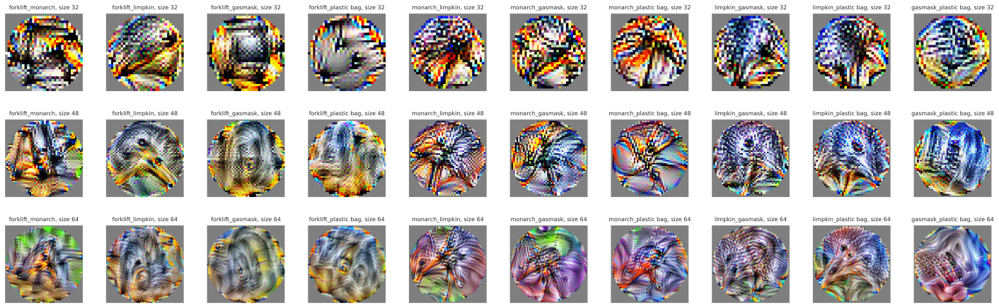

In [ ]:
show_patches(circle_original, patch_sizes, 8)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_original, acc='acc', rotations = [0, 30])
show_table_with_rotation(top_1=False, rot_patches=circle_original, acc='acc', rotations = [0, 30])

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch,0.14%,37.73%,11.33%,61.97%,20.61%,67.39%
forklift_limpkin,0.10%,13.55%,1.45%,49.85%,25.69%,82.94%
forklift_gasmask,0.25%,3.08%,5.96%,16.68%,19.08%,45.99%
forklift_plastic bag,0.01%,0.10%,6.86%,34.92%,26.35%,66.43%
monarch_limpkin,44.22%,14.69%,69.15%,67.33%,84.95%,87.42%
monarch_gasmask,44.55%,0.24%,67.05%,15.65%,79.36%,65.12%
monarch_plastic bag,53.29%,0.07%,69.89%,0.82%,79.48%,82.75%
limpkin_gasmask,15.20%,0.31%,63.63%,4.51%,81.44%,53.97%
limpkin_plastic bag,17.48%,0.08%,62.60%,21.36%,88.21%,81.43%
gasmask_plastic bag,0.24%,0.17%,17.27%,36.89%,68.55%,79.11%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch,1.55%,71.12%,32.05%,90.82%,47.64%,93.04%
forklift_limpkin,1.05%,35.37%,7.41%,80.76%,55.19%,97.41%
forklift_gasmask,2.30%,19.22%,21.30%,51.04%,46.91%,84.69%
forklift_plastic bag,0.16%,1.81%,25.92%,68.69%,56.35%,93.55%
monarch_limpkin,77.69%,37.09%,94.52%,92.57%,98.92%,98.61%
monarch_gasmask,79.10%,3.30%,93.02%,57.26%,97.46%,96.07%
monarch_plastic bag,85.52%,1.52%,94.52%,8.18%,97.53%,98.27%
limpkin_gasmask,38.57%,3.55%,89.84%,50.63%,96.94%,94.52%
limpkin_plastic bag,42.18%,2.41%,90.63%,59.10%,98.75%,98.06%
gasmask_plastic bag,2.96%,2.23%,57.07%,72.53%,95.78%,97.65%


#### Method 2

In [ ]:
circle_1_rot = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=10, rotation_angles = [0, 30], type="circle_fgsm", circle = True)

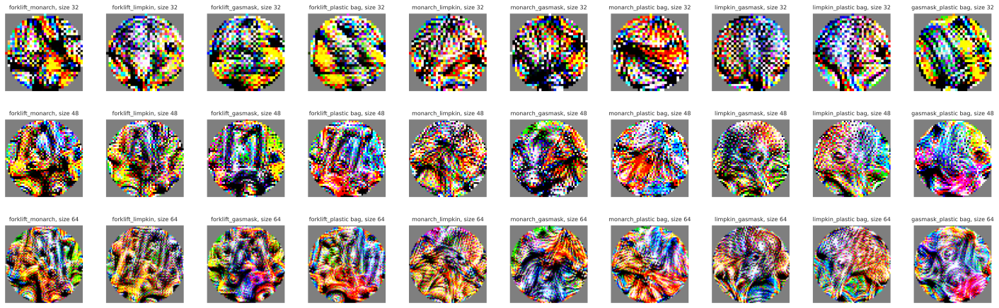

In [ ]:
show_patches(circle_1_rot, patch_sizes, 8)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_1_rot, acc='acc', rotations=[0])
show_table_with_rotation(top_1=False, rot_patches=circle_1_rot, acc='acc', rotations=[0])

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch,1.42%,59.59%,69.24%,88.20%,98.56%,98.68%
forklift_limpkin,0.07%,20.99%,57.72%,72.57%,96.84%,95.80%
forklift_gasmask,0.23%,6.33%,64.31%,66.05%,97.81%,98.93%
forklift_plastic bag,0.37%,0.61%,58.81%,69.21%,97.98%,98.11%
monarch_limpkin,48.81%,20.60%,85.99%,79.32%,98.26%,98.22%
monarch_gasmask,55.70%,8.06%,91.85%,93.96%,99.53%,99.86%
monarch_plastic bag,67.16%,0.63%,86.49%,77.85%,98.98%,98.73%
limpkin_gasmask,21.64%,1.51%,84.66%,92.49%,98.46%,99.59%
limpkin_plastic bag,24.46%,0.16%,78.41%,74.14%,97.10%,97.52%
gasmask_plastic bag,9.70%,1.02%,58.52%,67.56%,99.87%,99.08%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch,9.18%,89.71%,92.68%,99.29%,99.97%,99.97%
forklift_limpkin,0.91%,47.92%,85.27%,94.31%,99.85%,99.70%
forklift_gasmask,2.29%,30.91%,89.59%,95.09%,99.94%,99.97%
forklift_plastic bag,3.02%,4.66%,86.66%,94.85%,99.91%,99.96%
monarch_limpkin,81.61%,47.86%,98.95%,96.55%,99.98%,99.97%
monarch_gasmask,87.16%,32.62%,99.66%,99.78%,100.00%,99.99%
monarch_plastic bag,93.37%,10.62%,99.07%,97.39%,99.99%,99.98%
limpkin_gasmask,49.34%,14.39%,97.92%,99.63%,99.94%,99.99%
limpkin_plastic bag,54.36%,1.84%,96.39%,96.45%,99.87%,99.93%
gasmask_plastic bag,39.09%,9.24%,91.55%,94.14%,100.00%,99.98%


### 4 Rotations - 0, 30, 60, 90 Degrees

#### Method 1

In [ ]:
circle_4 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=20, rotation_angles = [0, 30, 60, 90], type="cir", circle = True)

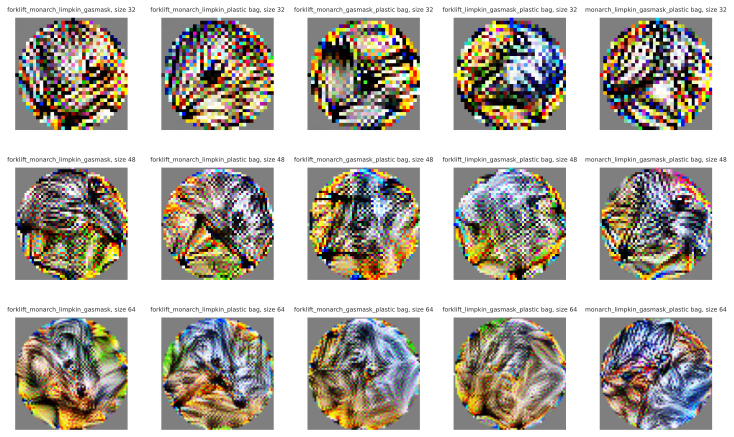

In [ ]:
show_patches(circle_4, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_4, acc='acc', rotations=[0])
show_table_with_rotation(top_1=False, rot_patches=circle_4, acc='acc', rotations=[0])

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch_limpkin_gasmask,0.01%,25.73%,2.70%,0.41%,1.15%,60.40%,33.52%,9.04%,19.46%,78.63%,65.65%,68.35%
forklift_monarch_limpkin_plastic bag,0.00%,26.08%,6.85%,0.04%,0.75%,63.60%,52.44%,7.50%,11.72%,76.85%,76.97%,50.59%
forklift_monarch_gasmask_plastic bag,0.02%,35.44%,0.01%,0.10%,3.52%,59.54%,20.58%,4.61%,15.35%,72.27%,25.23%,32.99%
forklift_limpkin_gasmask_plastic bag,0.06%,10.27%,0.27%,0.13%,0.59%,57.79%,3.63%,9.25%,16.67%,62.35%,31.86%,41.86%
monarch_limpkin_gasmask_plastic bag,40.58%,19.91%,1.35%,0.07%,45.57%,48.01%,7.57%,0.33%,71.79%,79.67%,68.97%,61.26%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch_limpkin_gasmask,0.21%,58.16%,10.02%,4.52%,7.16%,89.25%,62.68%,40.85%,46.14%,97.10%,90.21%,94.23%
forklift_monarch_limpkin_plastic bag,0.13%,58.48%,21.76%,1.14%,4.80%,91.41%,83.52%,33.66%,34.04%,96.82%,95.21%,84.61%
forklift_monarch_gasmask_plastic bag,0.26%,69.60%,0.47%,1.58%,17.59%,88.99%,58.42%,27.92%,39.60%,95.22%,68.30%,72.19%
forklift_limpkin_gasmask_plastic bag,0.62%,30.73%,3.36%,1.71%,5.32%,87.35%,26.34%,32.56%,42.35%,87.07%,75.65%,80.65%
monarch_limpkin_gasmask_plastic bag,75.04%,45.45%,11.07%,1.05%,79.24%,79.57%,41.76%,4.16%,95.03%,96.82%,96.57%,90.24%


#### Method 2

In [ ]:
circle_4_rot = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=20, rotation_angles = [0, 30, 60, 90], type="cir_fgsm", circle = True)

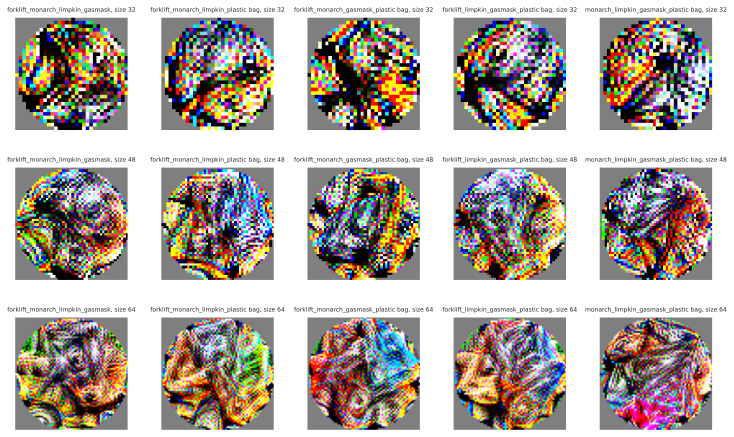

In [ ]:
show_patches(circle_4_rot, patch_sizes, 6)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_4_rot, acc='acc', rotations=[0])
show_table_with_rotation(top_1=False, rot_patches=circle_4_rot, acc='acc', rotations=[0])

Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch_limpkin_gasmask,0.01%,40.02%,14.69%,1.68%,0.73%,72.92%,64.42%,71.08%,93.67%,93.90%,92.98%,96.92%
forklift_monarch_limpkin_plastic bag,0.04%,43.36%,12.66%,0.05%,25.24%,73.99%,52.98%,10.39%,87.14%,91.96%,89.40%,85.87%
forklift_monarch_gasmask_plastic bag,0.10%,52.54%,2.95%,0.09%,38.72%,79.02%,58.84%,4.03%,77.30%,92.02%,92.41%,85.95%
forklift_limpkin_gasmask_plastic bag,0.04%,10.13%,1.83%,0.02%,1.55%,57.20%,68.56%,30.93%,81.00%,87.46%,92.00%,86.69%
monarch_limpkin_gasmask_plastic bag,42.70%,6.37%,1.18%,0.06%,67.24%,63.98%,71.28%,15.15%,89.24%,91.67%,93.94%,88.71%


Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
forklift_monarch_limpkin_gasmask,0.27%,73.38%,36.59%,9.93%,4.73%,95.55%,90.96%,95.38%,99.47%,99.78%,99.60%,99.90%
forklift_monarch_limpkin_plastic bag,0.37%,76.19%,34.17%,0.54%,61.12%,95.73%,83.72%,36.13%,98.37%,99.58%,98.96%,98.90%
forklift_monarch_gasmask_plastic bag,1.04%,84.60%,18.29%,1.27%,73.41%,97.48%,90.62%,26.42%,96.62%,99.59%,99.57%,99.00%
forklift_limpkin_gasmask_plastic bag,0.55%,28.04%,13.77%,0.55%,8.67%,85.61%,94.28%,68.70%,96.68%,98.58%,99.59%,99.23%
monarch_limpkin_gasmask_plastic bag,75.89%,21.60%,9.24%,0.73%,93.09%,90.35%,95.78%,50.22%,99.29%,99.28%,99.77%,99.49%


### 12 Rotations

In [ ]:
class_names =  ['minibus', 'slug', 'European fire salamander', 'reflex camera', 'tabby', 'Siberian husky', 'komondor', 'dowitcher', 'radio', 'wallaby', 'packet', 'reel']

#### Method 1

In [ ]:
circle_12 = get_patches(class_names, patch_sizes, patch_attack=patch_attack, num_epochs=20, rotation_angles = rot_12, type="cir_fgsm", circle = True)

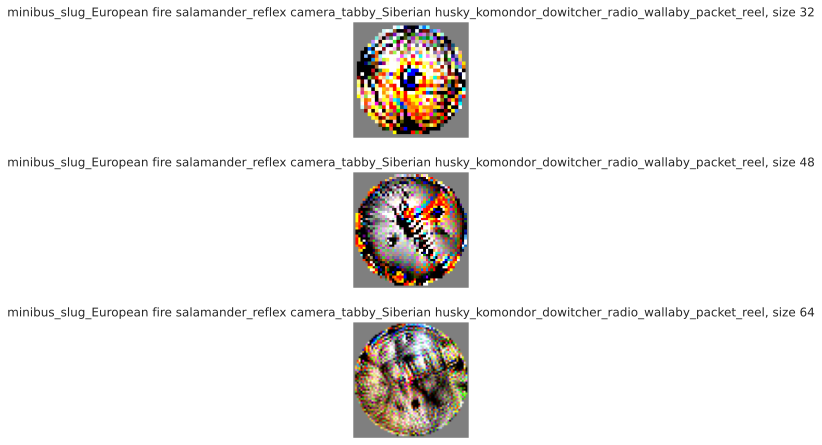

In [ ]:
show_patches(circle_12, patch_sizes, 12)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_12, acc='acc', rotations=rot_12)
show_table_with_rotation(top_1=False, rot_patches=circle_12, acc='acc', rotations=rot_12)

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°,Rot 120°,Rot 120°,Rot 120°,Rot 150°,Rot 150°,Rot 150°,Rot 180°,Rot 180°,Rot 180°,Rot 210°,Rot 210°,Rot 210°,Rot 240°,Rot 240°,Rot 240°,Rot 270°,Rot 270°,Rot 270°,Rot 300°,Rot 300°,Rot 300°,Rot 330°,Rot 330°,Rot 330°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.01%,0.00%,0.08%,0.00%,0.00%,0.10%,0.01%,0.00%,0.03%,0.01%,0.01%,0.52%,0.03%,0.00%,0.03%,0.01%,0.00%,0.18%,0.02%,0.02%,0.12%,0.01%,0.01%,1.00%,0.01%,0.01%,4.24%,0.10%,0.04%,0.35%,0.39%,0.02%,0.32%,0.04%,0.03%,12.69%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°,Rot 120°,Rot 120°,Rot 120°,Rot 150°,Rot 150°,Rot 150°,Rot 180°,Rot 180°,Rot 180°,Rot 210°,Rot 210°,Rot 210°,Rot 240°,Rot 240°,Rot 240°,Rot 270°,Rot 270°,Rot 270°,Rot 300°,Rot 300°,Rot 300°,Rot 330°,Rot 330°,Rot 330°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.33%,0.01%,2.61%,0.11%,0.17%,0.57%,0.21%,0.10%,0.55%,0.18%,0.20%,6.07%,0.48%,0.08%,0.59%,0.24%,0.10%,1.00%,0.12%,0.10%,0.83%,0.15%,0.27%,8.40%,0.48%,0.34%,23.47%,1.28%,0.57%,2.16%,2.80%,0.47%,2.23%,0.27%,0.39%,42.40%


#### Method 2

In [ ]:
circle_12_rot = get_patches(class_names, patch_sizes, patch_attack=patch_attack_rot_multi_fgsm, num_epochs=20, rotation_angles = rot_12, type="cir_fgsm", circle = True)

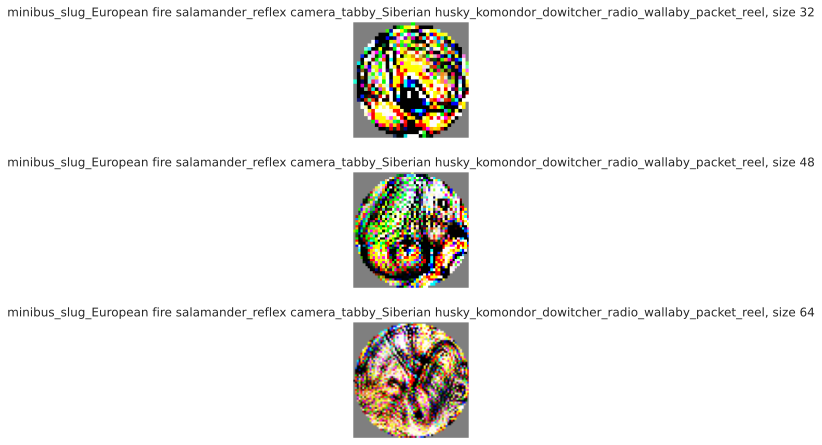

In [ ]:
show_patches(circle_12_rot, patch_sizes, 12)

In [ ]:
show_table_with_rotation(top_1=True, rot_patches=circle_12_rot, acc='acc', rotations=rot_12)
show_table_with_rotation(top_1=False, rot_patches=circle_12_rot, acc='acc', rotations=rot_12)

,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°,Rot 120°,Rot 120°,Rot 120°,Rot 150°,Rot 150°,Rot 150°,Rot 180°,Rot 180°,Rot 180°,Rot 210°,Rot 210°,Rot 210°,Rot 240°,Rot 240°,Rot 240°,Rot 270°,Rot 270°,Rot 270°,Rot 300°,Rot 300°,Rot 300°,Rot 330°,Rot 330°,Rot 330°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.01%,0.00%,16.02%,0.01%,0.00%,0.09%,0.02%,0.02%,0.06%,0.01%,0.01%,1.46%,0.10%,0.01%,39.42%,0.23%,0.00%,0.35%,0.02%,0.02%,0.52%,0.04%,0.08%,18.74%,0.05%,25.27%,44.63%,0.46%,9.34%,6.51%,11.75%,47.62%,3.66%,0.11%,0.03%,41.98%


,Rot 0°,Rot 0°,Rot 0°,Rot 30°,Rot 30°,Rot 30°,Rot 60°,Rot 60°,Rot 60°,Rot 90°,Rot 90°,Rot 90°,Rot 120°,Rot 120°,Rot 120°,Rot 150°,Rot 150°,Rot 150°,Rot 180°,Rot 180°,Rot 180°,Rot 210°,Rot 210°,Rot 210°,Rot 240°,Rot 240°,Rot 240°,Rot 270°,Rot 270°,Rot 270°,Rot 300°,Rot 300°,Rot 300°,Rot 330°,Rot 330°,Rot 330°
Class pair,Orig 32x32,Orig 48x48,Orig 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64,Rotated 32x32,Rotated 48x48,Rotated 64x64
minibus_slug_European fire salamander_reflex camera_tabby_Siberian husky_komondor_dowitcher_radio_wallaby_packet_reel,0.42%,0.09%,44.83%,0.19%,0.20%,0.44%,0.23%,0.20%,0.90%,0.14%,0.33%,11.16%,0.85%,0.18%,74.10%,4.01%,0.30%,1.82%,0.30%,0.12%,3.68%,0.45%,0.60%,55.99%,0.80%,59.37%,80.92%,7.05%,55.09%,26.97%,36.71%,79.88%,19.98%,0.56%,0.39%,79.44%


## Results

**No Rotations (Baseline)**

---

In the baseline experiment without rotations, both methods showed a clear trend of improved accuracy with higher patch sizes. Method 2 consistently outperformed Method 1 across all classes and resolutions, achieving significantly higher Top-1 and Top-5 accuracy. This indicates that Method 2 is more effective in handling the classification task when no data augmentation is applied. The results highlight the importance of resolution in model performance, with higher resolutions leading to better outcomes for both methods.






**2 Rotations ( 0° \ 30°)**

---

In the example below, we can see how the same patch looks in different rotation.




Method 1:

In [ ]:
circle_patch = circle_original['monarch_limpkin'][64]['patch']

rot_patches = {}
rot_patches['monarch (0°)'] = {}
rot_patches['monarch (0°)'][64] = {}
rot_patches['monarch (0°)'][64]['patch'] = circle_patch

rotated_patch = TF.rotate(circle_patch, angle=30, expand=False)

rot_patches['limpkin (30°)'] = {}
rot_patches['limpkin (30°)'][64] = {}
rot_patches['limpkin (30°)'][64]['patch'] = rotated_patch

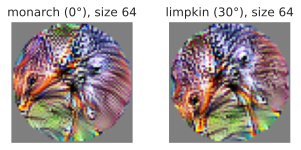

In [ ]:
show_patches(rot_patches, [64], txt_size=12)

Method 2:

In [ ]:
circle_patch = circle_1_rot['monarch_limpkin'][64]['patch']

rot_patches = {}
rot_patches['monarch (0°)'] = {}
rot_patches['monarch (0°)'][64] = {}
rot_patches['monarch (0°)'][64]['patch'] = circle_patch

rotated_patch = TF.rotate(circle_patch, angle=30, expand=False)

rot_patches['limpkin (30°)'] = {}
rot_patches['limpkin (30°)'][64] = {}
rot_patches['limpkin (30°)'][64]['patch'] = rotated_patch

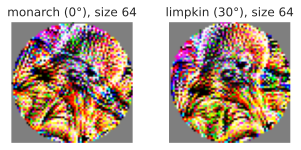

In [ ]:
show_patches(rot_patches, [64], txt_size=12)

Now, we can see the results of the attack using all patch sizes & use the 2 rotations of patches.

Method 1:

32 X 32

monarch


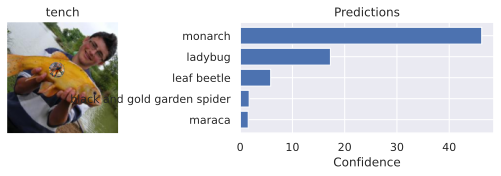

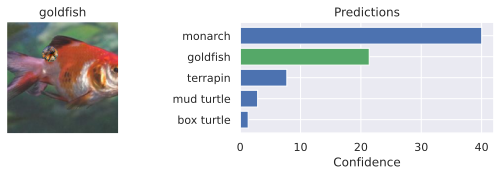

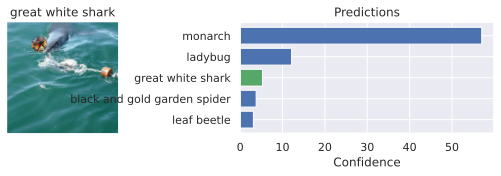

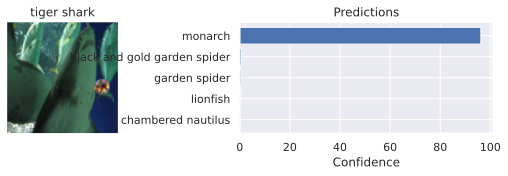

limpkin


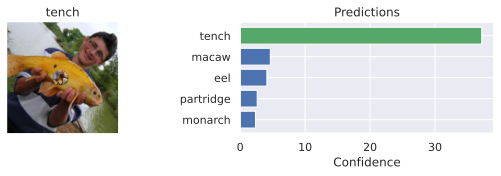

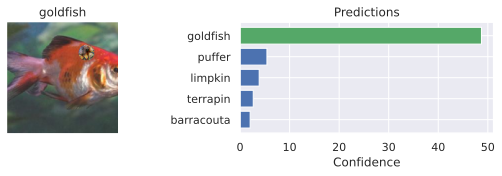

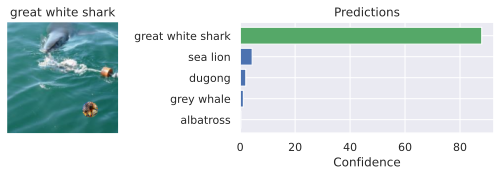

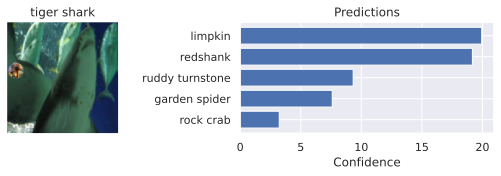

In [ ]:
circle_patch = circle_original['monarch_limpkin'][32]['patch']
perform_patch_attack(circle_patch, circle = True, rotations=[0, 30], target=['monarch', 'limpkin'])

48 X 48

monarch


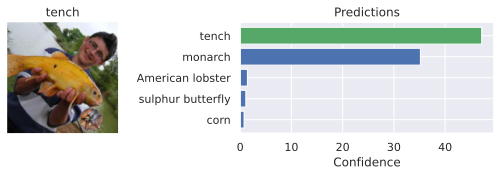

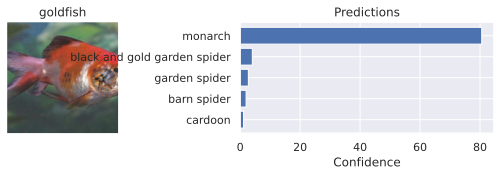

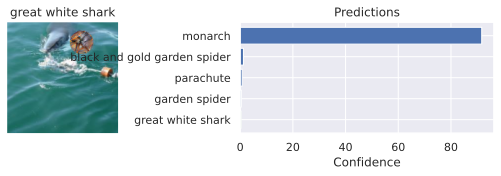

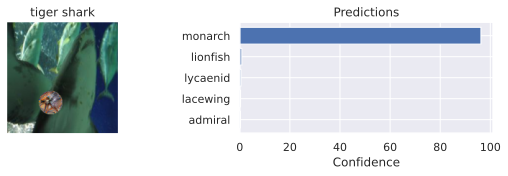

limpkin


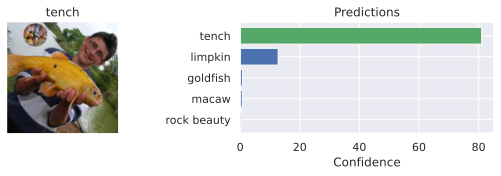

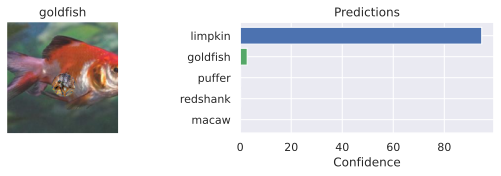

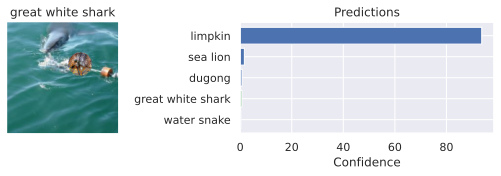

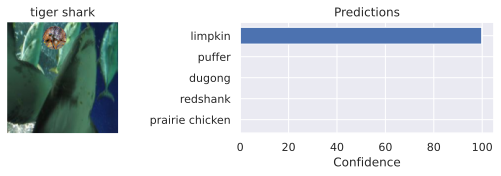

In [ ]:
circle_patch = circle_original['monarch_limpkin'][48]['patch']
perform_patch_attack(circle_patch, circle = True, rotations=[0, 30], target=['monarch', 'limpkin'])

64 X 64

monarch


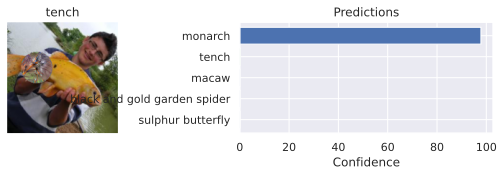

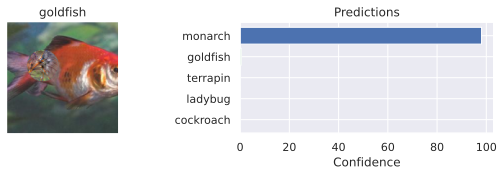

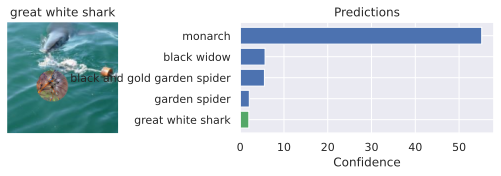

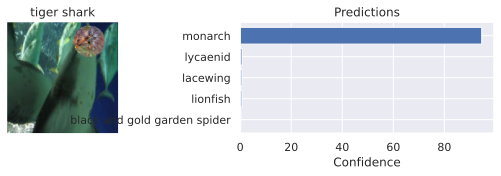

limpkin


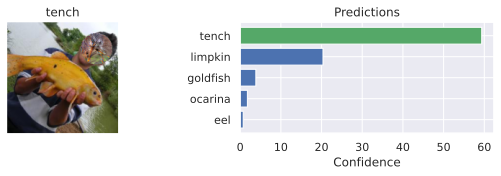

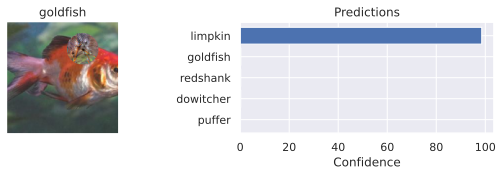

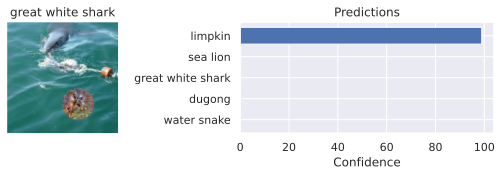

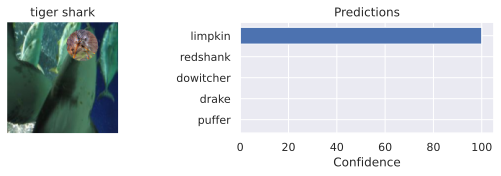

In [ ]:
circle_patch = circle_original['monarch_limpkin'][64]['patch']
perform_patch_attack(circle_patch, circle = True, rotations=[0, 30], target=['monarch', 'limpkin'])

Method 2:

32 X 32

monarch


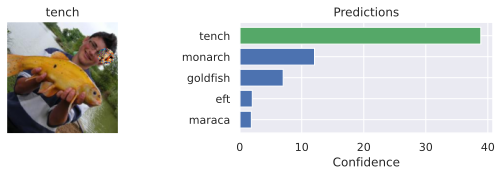

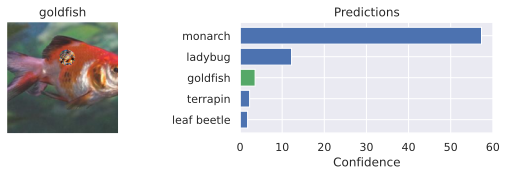

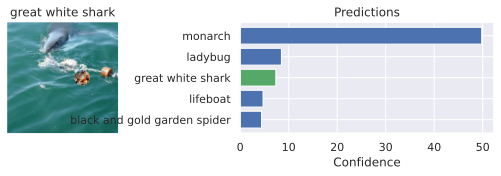

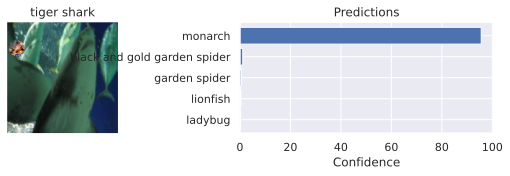

limpkin


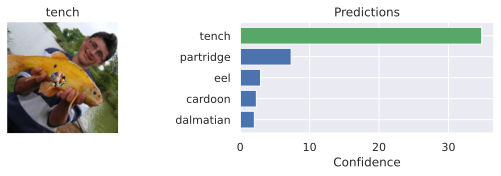

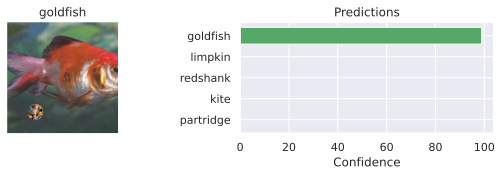

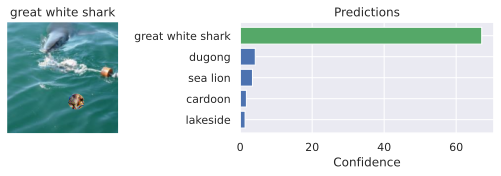

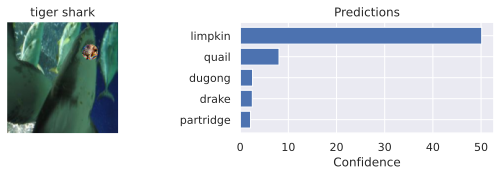

In [ ]:
circle_patch = circle_1_rot['monarch_limpkin'][32]['patch']
perform_patch_attack(circle_patch, circle = True, rotations=[0, 30], target=['monarch', 'limpkin'])

48 X 48

monarch


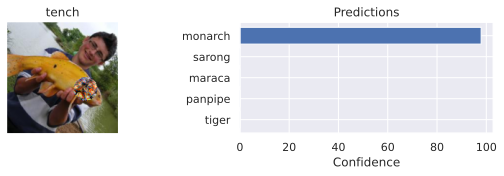

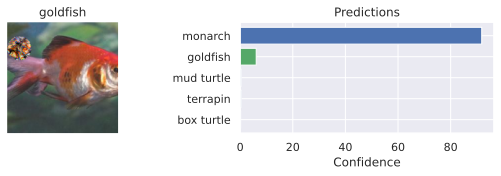

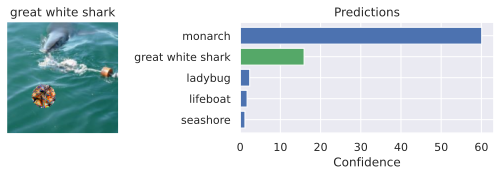

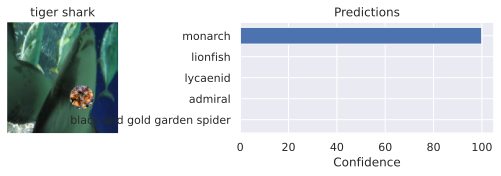

limpkin


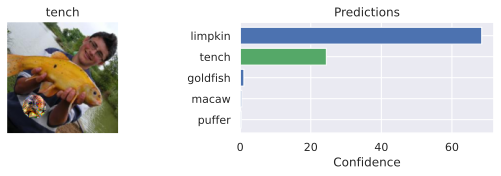

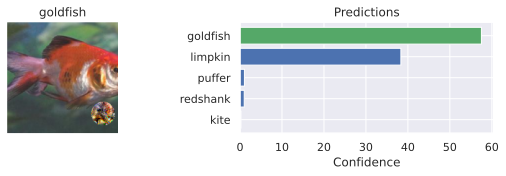

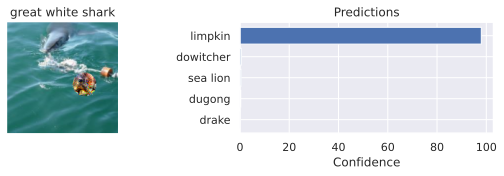

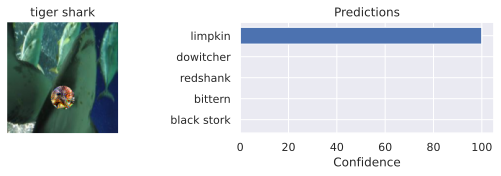

In [ ]:
circle_patch = circle_1_rot['monarch_limpkin'][48]['patch']
perform_patch_attack(circle_patch, circle = True, rotations=[0, 30], target=['monarch', 'limpkin'])

64 X 64

monarch


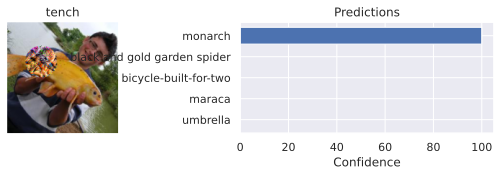

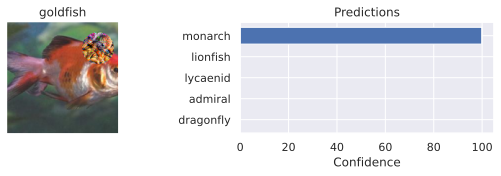

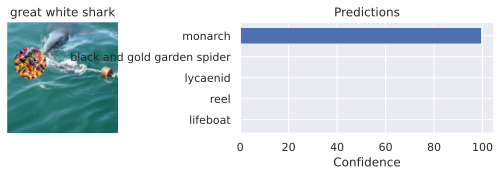

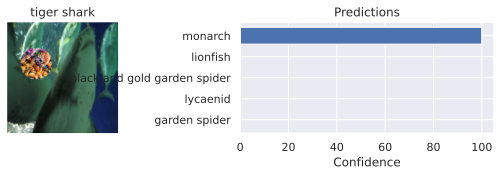

limpkin


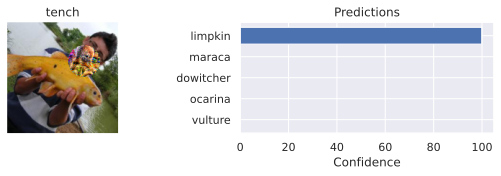

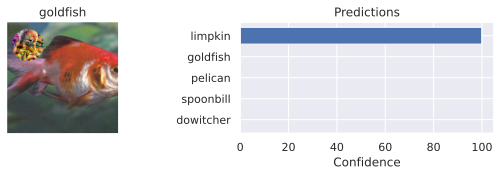

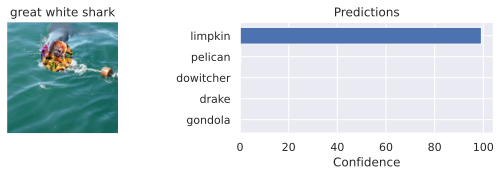

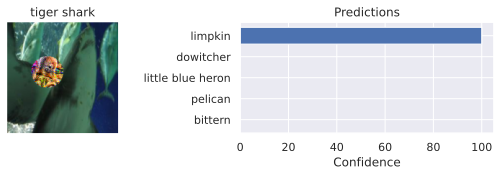

In [ ]:
circle_patch = circle_1_rot['monarch_limpkin'][64]['patch']
perform_patch_attack(circle_patch, circle = True, rotations=[0, 30], target=['monarch', 'limpkin'])

When the adversarial patch was rotated at 0° and 30°, the success of the attack depended on the method used. Method 2 worked better than Method 1, fooling the model more effectively, as shown by its lower accuracy scores.


**4 Rotations (0° \ 30° \ 60° \ 90°)**

The experiment with four rotation angles (0°, 30°, 60°, and 90°) revealed distinct patterns in performance for both methods. Method 1 showed considerable variation in Top-1 accuracy depending on the rotation angle, with 90° rotations yielding the highest performance, but still lower than Method 2. The Top-5 accuracy for Method 1 followed similar trends, peaking at 90° rotations, reaching over 97%. In contrast, Method 2 exhibited consistently higher Top-1 and Top-5 accuracy, with near-perfect performance at 90° rotations, reaching nearly 94% for Top-1 and exceeding 99% for Top-5. These findings indicate that while both methods are sensitive to rotation angles, Method 2 consistently outperforms Method 1 across all conditions. Additionally, higher patch size continues to correlate with improved accuracy, particularly for rotated images.


---

**12 Rotations**

With 12 rotations, the adversarial attack reached a high level of complexity, challenging the patches' ability to consistently deceive the model. Method 2 maintained its advantage over Method 1, with its patches remaining highly effective across a wide range of orientations. While both methods faced some difficulty at lower patch size, Method 2 demonstrated greater scalability and success at higher resolutions.



---


In [ ]:
import pandas as pd
import plotly.express as px

# Define constants
method1_color = '#553E56'  # (85, 62, 86)
method2_color = '#3494BA'  # (52, 148, 186)
custom_palette = {"Method 1": method1_color, "Method 2": method2_color}

# Create the data
data_list = []
rotations = [
    "No Rotations", "1 Rotation (0°,30°)",
    "3 Rotations (0°-90°)",  "12 Rotations"
]
patch_sizes = ["32x32", "48x48", "64x64"]

# Restructure the data for plotly
for rotation in rotations:
    for method in [1, 2]:
        for patch in patch_sizes:
            if patch == "32x32":
                val = {
                    "Rotation": rotation,
                    "Method": f"Method {method}",
                    "Patch Size": patch,
                    "Top1 Accuracy": [7.39, 24.27, 26.45, 0.05][rotations.index(rotation)] if method == 1 else [24.65, 50.5, 40.89, 1.07][rotations.index(rotation)]
                }
            elif patch == "48x48":
                val = {
                    "Rotation": rotation,
                    "Method": f"Method {method}",
                    "Patch Size": patch,
                    "Top1 Accuracy": [24.45, 32.19, 23.42, 0.01][rotations.index(rotation)] if method == 1 else [87.96, 55.14, 43.91, 6.87][rotations.index(rotation)]
                }
            else:  # 64x64
                val = {
                    "Rotation": rotation,
                    "Method": f"Method {method}",
                    "Patch Size": patch,
                    "Top1 Accuracy": [43.91, 54.39, 34.53, 1.64][rotations.index(rotation)] if method == 1 else [99.35, 86.03, 62.65, 14.45][rotations.index(rotation)]
                }
            data_list.append(val)

# Create DataFrame
df = pd.DataFrame(data_list)

# Create the grouped bar plot
fig = px.bar(
    df,
    x="Rotation",
    y="Top1 Accuracy",
    color="Method",
    barmode="group",
    color_discrete_map=custom_palette,
    text_auto='.1f',
    title='Average Top1 Performance by Rotation Type and Method',
    labels={"Performance": "Top1 Accuracy (%)", "Rotation": "Rotation Type"},
    custom_data=["Patch Size"],  # Add Patch Size to hover data
)

# Customize the hover template
fig.update_traces(
    hovertemplate="<b>Rotation:</b> %{x}<br>" +
                  "<b>Method:</b> %{fullData.name}<br>" +
                  "<b>Performance:</b> %{y:.1f}%<br>" +
                  "<b>Patch Size:</b> %{customdata[0]}<br>" +
                  "<extra></extra>",  # Remove extra hover info
    textfont_size=14,
    textangle=0,
    textposition="outside",
    cliponaxis=False,
)

# Customize the plot layout
fig.update_layout(
    xaxis_title="Rotation Type",
    yaxis_title="Top1 Accuracy (%)",
    legend_title="Method",
    font=dict(size=14),
    xaxis=dict(tickangle=45),
    title_font_size=16,
    height=600,
    width=1200,
)

# Show the plot
fig.show()

# Discussion

Method 2 consistently outperforms Method 1 in generating effective adversarial patches across all experiments, patch shapes, and rotation scenarios. It achieves significantly higher attack success rates, as reflected by lower Top1 and Top5 accuracy scores, demonstrating its ability to better fool the model. While both methods perform better with larger patch sizes and fewer rotations, Method 2 maintains its effectiveness even in complex scenarios, such as multiple rotations or smaller patches. Square patches generally yield slightly better results than circular patches, but Method 2's adaptability ensures high success rates for both shapes. As the number of rotations increases, the attack becomes more challenging, and both methods see a decline in performance, though Method 2 remains more robust.

In [ ]:
import pandas as pd
import plotly.express as px

# Define constants
SIZE = 14
shape_colors = {"Square": "#553E56", "Circle": "#3494BA"}  # Custom colors for shape
patch_size_colors = {"32x32": "#A3D39C", "48x48": "#553E56", "64x64": "#3494BA"}  # Custom colors for patch size

# Sample data (replace with your actual data)
data = {
    "Rotation": ["No Rotations", "2 Rotation\n(0°,30°)",  "4 Rotations\n(0°, 30°, 60°, 90°)", "12 Rotations"] * 6,
    "Shape": ["Square"] * 4 + ["Circle"] * 4 + ["Square"] * 4 + ["Circle"] * 4 + ["Square"] * 4 + ["Circle"] * 4,
    "Patch Size": ["32x32"] * 8 + ["48x48"] * 8 + ["64x64"] * 8,
    "Top1 Accuracy": [
        14.66, 19.66, 25.31,  0.01,  # Square, 32x32
        7.39, 24.27, 26.45, 0.05,        # Circle, 32x32
        48.20, 32.65, 29.08, 0.02,  # Square, 48x48
        24.45, 32.19, 23.42, 0.01,      # Circle, 48x48
        74.25, 53.13, 39.73,  1.15,  # Square, 64x64
        43.91, 54.39, 34.53, 1.64,     # Circle, 64x64
    ]
}

# Create DataFrame
df = pd.DataFrame(data)

# Function to create comparison plots
def create_comparison_plot(df, x, y, hue, palette, title, y_axis_title):
    """
    Creates a grouped bar chart for comparing performance across categories.

    Parameters:
        df (pd.DataFrame): Input data.
        x (str): Column for x-axis.
        y (str): Column for y-axis.
        hue (str): Column for grouping (color).
        palette (dict): Custom colors for hue categories.
        title (str): Title of the plot.
        y_axis_title (str): Title of the y-axis.

    Returns:
        fig: Plotly figure object.
    """
    fig = px.bar(
        df,
        x=x,
        y=y,
        color=hue,
        barmode="group",
        color_discrete_map=palette,
        text_auto='.1f',
        title=title,
        labels={y: y_axis_title, x: "Rotation Type"},
        hover_data={"Patch Size": True}  # Add Patch Size to hover data
    )

    # Customize the hover template
    fig.update_traces(
        hovertemplate=f"<b>Rotation:</b> %{{x}}<br>" +
                      f"<b>{hue}:</b> %{{fullData.name}}<br>" +
                      f"<b>Patch Size:</b> %{{customdata[0]}}<br>" +
                      f"<b>{y}:</b> %{{y:.1f}}%<br>" +
                      "<extra></extra>",  # Remove extra hover info
        textfont_size=SIZE,
        textangle=0,
        textposition="outside",
        cliponaxis=False,
    )

    # Customize the plot layout
    fig.update_layout(
        xaxis_title="Rotation Type",
        yaxis_title=y_axis_title,
        legend_title=hue,
        font=dict(size=SIZE),
        xaxis=dict(tickangle=45),
        title_font_size=SIZE + 2,
        height=600,
        width=1200,
    )

    return fig

# Plot 1: Comparison by Rotation Type and Patch Shape
shape_fig = create_comparison_plot(
    df,
    x="Rotation",
    y="Top1 Accuracy",
    hue="Shape",
    palette=shape_colors,
    title="Comparison of Performance by Rotation Type and Patch Shape",
    y_axis_title="Top1 Accuracy (%)",
)
shape_fig.show()

# Plot 2: Comparison by Rotation Type and Patch Size
patch_size_fig = create_comparison_plot(
    df,
    x="Rotation",
    y="Top1 Accuracy",
    hue="Patch Size",
    palette=patch_size_colors,
    title="Comparison of Performance by Rotation Type and Patch Size",
    y_axis_title="Top1 Accuracy (%)",
)
patch_size_fig.show()
